L'objectif de cette partie est de faire une analyse des données météo pour les différentes régions de France. 
On se limite aux régions métropolitaines et à la mesure de température pour cette analyse.
Les données : pour chaque région nous avions assemblé les données météo des différents postes entre 01/01/2023 au 31/12/2024, ces mesures sont effectuées au pas d'une heures.*

Notation : pour une région $i$, un poste $j$ on note $T_{ij}(t,\omega)$ (noté simplment $T_{ij}(t)$ ) le processus aléatoire, qui correspond à la mesure de la température à la date t, t mesurée en heures de 01/01/2023 au 31/12/2024.

Ce processus faiblement stationnaire, voir non-stationnaire. Pour faire correctement l'analyse, une différentiation du premier et/ou second ordre permet de supprimer cette non-stationnarité. On peut aussi utiliser la décomposition des séries temporelles (tendance, saisonnalité et résidu).

 
Pour chaque région $i$ cette analyse consiste à étudier :
- la distribution de chaque processus $T_{ij}(t)$
- les distributions des processus issues de la différentiation du premier et du second ordre :  $\Delta{T_{ij}(t)}$ et  ${\Delta^2}{T_{ij}(t)}$ 
- Les corrélations entre ces processus :  pour éviter la complexité calculatoire et d'affichage, un sous-ensemble est étudié, on se limite à 10 postes par région 
- la distribution du processus moyenne  : $T_{i}(t) = \frac{1}{N_i}\sum_{i=1}^{N_i}T_{ij}(t) $ où $N_i$ est le nombre de poste pour la région $i$
- la distribution du processus moyenne du déparetement centre  géographique de la région  : $T_{C_i}(t) = \frac{1}{N_{C_i}}\sum_{i=1}^{N_{C_i}}T_{ij}(t) $, où  $N_{C_i}$ est le nombre de postes du département centre de la région $i$
- les distributions des processus issues de la différentiation du premier et second ordre pour $T_{i}(t)$ et  $T_{C_i}(t)$
- la corrélation entre ces mesures avec les autres régions




In [ ]:
############ Auteur: Y.s ###########
############ Mars 2024 ##############


import os
import requests
import sys
import gzip

import datetime
import time




import pandas as pd
import numpy as np


import matplotlib.pyplot as plt
get_ipython().run_line_magic('matplotlib', 'inline')
from ipywidgets import interact, IntSlider, FloatSlider, Dropdown, Button, HBox, VBox
import ipywidgets as widgets
import seaborn as sns
import pylab

# Scipy
import scipy.stats as stats
from scipy.stats import shapiro
from scipy.stats import ks_2samp


# Stat
from statsmodels.tsa.seasonal import seasonal_decompose



In [3]:
# Répertoires de travail
folder_projet_BD = r"D:\MesDocuments\Formation\DataScientist_PSL\Projet\BD"
folder_BD_meteo_region_dist  = os.path.join(folder_projet_BD, 'Meteo/region_T')
folder_BD_meteo = os.path.join(folder_projet_BD, 'Meteo\CSV')
folder_BD_meteo_region_centre  = os.path.join(folder_projet_BD, 'Meteo/centre_region_T')

# Création d'un répertoir s'il n'existe pas pour stocker uniquement les données "température" 
# en raison d'un fichier par région pour la période 2023-2024
# chaque colonne  représente un poste de mesure
# une ligne est une mesure au pas d'une heure
# L'indexation est faite par AAAAMMJJHH (l'heure de mesure)
if not os.path.isdir(folder_BD_meteo_region_dist):
    os.mkdir(folder_BD_meteo_region_dist)

if not os.path.isdir(folder_BD_meteo_region_centre):
    os.mkdir(folder_BD_meteo_region_centre)

In [4]:
# Téléchargement de la BD contennat les départements de chaque région
filename = 'departements-region.csv'
file = os.path.join(folder_BD_meteo, filename)
df_depa_region = pd.read_csv(file)

# Je remplace les espace par un '-' dans les noms des régions
df_depa_region['region_name'] = df_depa_region['region_name'].apply(lambda s : s.replace(" ", '-'))

Liste_region = df_depa_region['region_name'].unique().tolist()

# df_depa_region['region_name'].unique() # pour vérifer
# Je supprime les régions  ['Guadeloupe', 'Martinique', 'Guyane','La-Réunion', 'Mayotte', 'Corse']

for elem in ['Guadeloupe', 'Martinique', 'Guyane','La-Réunion', 'Mayotte', 'Corse']:
    Liste_region.remove(elem)

# Construction d'un dictionnaire de clés région et de valeurs la liste des nuémros de départements de chaque région 
dictionnaire__departement_region = {}

for reg in Liste_region:
    dictionnaire__departement_region[reg] = df_depa_region.loc[df_depa_region['region_name']==reg, 'num_dep'].tolist()




In [5]:
#print(dictionnaire__departement_region)
print("Liste_region=",Liste_region)

Liste_region= ['Auvergne-Rhône-Alpes', 'Hauts-de-France', "Provence-Alpes-Côte-d'Azur", 'Grand-Est', 'Occitanie', 'Normandie', 'Nouvelle-Aquitaine', 'Centre-Val-de-Loire', 'Bourgogne-Franche-Comté', 'Bretagne', 'Pays-de-la-Loire', 'Île-de-France']


In [ ]:

# On analyse pour la température entre 2020 -2023
columns_to_keep = ['AAAAMMJJHH','T'] 

# Un fichir csv par région pour 2020-2023 --> cela nous permet de récupérer 2023
template_start= 'H_' # début du nom du fichier
template_end_2020='_previous-' + str(2020) + '-' + str(2023) + '.csv'


# Un fichir csv par région pour 2024-2025 --> cela nous permet de récupérer 2023
template_end_2024='_latest-' + str(2024) + '-' + str(2025) + '.csv'

# Fichier de sortie
template_start_reg= 'T_' # début du nom du fichier
template_end_reg='-' + str(2023) + '-' + str(2024) + '.csv'

for reg, list_dep in dictionnaire__departement_region.items():
    print("... Nous traitons la région", reg)
    premier_departement = True
    for dep in list_dep:
        # #Lecture de la dataframe avec des données 2020-2023
        filename  = f"{template_start}{dep}{template_end_2020}" 
        file = os.path.join(folder_BD_meteo, filename)
        # Chargement de la base de données 2020-2023
        df_2023_dep =  pd.read_csv(file, sep=';')
        # On ne garde que les lignes de 2023
        df_2023_dep = df_2023_dep.loc[df_2023_dep['AAAAMMJJHH']>=2023010100]
    
        # Lecture des fichiers 2024-2025
        filename  = f"{template_start}{dep}{template_end_2024}" 
        file = os.path.join(folder_BD_meteo, filename)
        # Chargement de la base de données 2024-2025
        df_2024_dep =  pd.read_csv(file, sep=';')
        # On ne garde que les lignes de 2024
        df_2024_dep = df_2024_dep.loc[df_2024_dep['AAAAMMJJHH']<2025010100]


        # Union des deux df 2023 et 2024  
        df_2023_2024 = pd.concat([df_2023_dep, df_2024_dep], ignore_index=True)

        # On transpose les données de chaque poste en une colonne nomme NOM_USUEL_T
        df_2023_2024_pivot = df_2023_2024.pivot(index="AAAAMMJJHH", columns="NOM_USUEL", values="T")
        
        # on concaténe aeavec la df de la région
        if premier_departement == True: # Création d'un nouveau dataframe
            df_T = df_2023_2024_pivot
            premier_departement = False 
        else : 
            df_T = pd.concat([df_T,df_2023_2024_pivot], axis = 1)
     

    df_T = df_T.reset_index()
    # Extraction et ajout des champs année, mois, jours, heure
    df_info = pd.to_datetime(df_T['AAAAMMJJHH'].astype(str), 
                                 format ="%Y%m%d%H").apply(lambda t: pd.Series({'date': t.date(),
                                                                                'year': t.year,
                                                                                #'month': t.month,
                                                                                'month_n': t.strftime("%B"),
                                                                                'day': t.day,
                                                                                #'day_n': t.strftime("%A"),
                                                                                'h': t.hour + 1,
                                                                                #'mn': t.minute,
                                                                                #'s': t.second,
                                                                                }))
    df_T[df_info.columns] = df_info
    df_T.dropna( axis = 1, inplace = True)
    # On sauvegarde dans un CSV : nom   = H_region-2023-2024.csv" 
    filename = f"{template_start_reg}{reg}{template_end_reg}" 
    file = os.path.join(folder_BD_meteo_region_dist, filename)
    df_T.reset_index()
    df_T.to_csv(file, index=False)


... Nous traitons la région Auvergne-Rhône-Alpes
... Nous traitons la région Hauts-de-France
... Nous traitons la région Provence-Alpes-Côte-d'Azur
... Nous traitons la région Grand-Est
... Nous traitons la région Occitanie
... Nous traitons la région Normandie
... Nous traitons la région Nouvelle-Aquitaine
... Nous traitons la région Centre-Val-de-Loire
... Nous traitons la région Bourgogne-Franche-Comté
... Nous traitons la région Bretagne
... Nous traitons la région Pays-de-la-Loire
... Nous traitons la région Île-de-France


In [6]:



template_start_reg= 'T_' # début du nom du fichier
template_end_reg='-' + str(2023) + '-' + str(2024) + '.csv'
i = 1
Liste_region = ['Auvergne-Rhône-Alpes', 
                'Hauts-de-France', 
                "Provence-Alpes-Côte-d'Azur", 
                'Grand-Est', 
                'Occitanie', 
                'Normandie', 
                'Nouvelle-Aquitaine', 
                'Centre-Val-de-Loire', 
                'Bourgogne-Franche-Comté', 
                'Bretagne', 
                'Pays-de-la-Loire', 
                'Île-de-France']

for reg in Liste_region:
    print('######################################################################################################################################################################################')
    print('Region', reg)
    print('######################################################################################################################################################################################')

    # On lit les df  à partir des CSV 
    filename = f"{template_start_reg}{reg}{template_end_reg}" 
    file = os.path.join(folder_BD_meteo_region_dist, filename)
    df_T = pd.read_csv(file)
    print("Fin de lecture")
    #  Pour étudier la corrélation on ne garde que les colonnes qui correspondent  uax mesure de température 
    #  Liste des colonnes qui nous intéresse
    L = df_T.columns.to_list()
    for elem in ['AAAAMMJJHH','date', 'year', 'month_n','day', 'h']:
        L.remove(elem)

    
    # Différenciation du premier ordre et du second ordre
    df_diff_1 = df_T[L].diff().dropna()
    df_diff_2 = df_T[L].diff().diff().dropna()
    corr_pearson_1 = df_diff_1.corr(method='pearson')  # Corrélation linéaire
    corr_pearson_2= df_diff_2.corr(method='pearson') 
    #corr_spearman = df_T[L].corr(method='spearman')  # Corrélation monotone
    
    #print("Corrélation Pearson diff 1")
    display(corr_pearson_1)
    #print("Corrélation Pearson diff 2")
    display(corr_pearson_2)
  
    

    
   
    


######################################################################################################################################################################################
Region Auvergne-Rhône-Alpes
######################################################################################################################################################################################
Fin de lecture


,AMBERIEU,BELLEY,DIVONNE ZA,NANTUA,CHAREIL-CINTRAT_SAPC,DURDAT-LAREQUILLE,ECHASSIERES_SAPC,FERTE-HAUTERIVE,LA GUILLERMIE,PARAY-SOUS-BRIAILLES,...,GROISY_SAPC,LES CARROZ,MONT ARBOIS,PERS JUSSY,REPOSOIR (LE),SAMOENS,SERVOZ,USINENS SA,VACHERESSE,VALLORCINE
AMBERIEU,1.000000,0.633950,0.596301,0.585955,0.592417,0.534702,0.483075,0.603882,0.462494,0.600370,...,0.580153,0.503365,0.340537,0.515353,0.516127,0.556458,0.571237,0.605214,0.530800,0.444504
BELLEY,0.633950,1.000000,0.625953,0.544713,0.569703,0.512069,0.450489,0.580739,0.437056,0.578008,...,0.626904,0.520602,0.354563,0.555377,0.549346,0.589147,0.613110,0.685406,0.554235,0.461203
DIVONNE ZA,0.596301,0.625953,1.000000,0.546082,0.569960,0.534101,0.485220,0.576182,0.449705,0.577020,...,0.641214,0.538441,0.357237,0.563147,0.559428,0.609916,0.607656,0.629056,0.589581,0.474673
NANTUA,0.585955,0.544713,0.546082,1.000000,0.507320,0.493271,0.428095,0.515612,0.434319,0.518075,...,0.530235,0.458140,0.323112,0.488603,0.548114,0.538719,0.539407,0.551293,0.561732,0.505421
CHAREIL-CINTRAT_SAPC,0.592417,0.569703,0.569960,0.507320,1.000000,0.627810,0.609811,0.816397,0.517794,0.834569,...,0.540490,0.482041,0.311114,0.458511,0.502791,0.540965,0.559974,0.538858,0.515855,0.438454
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SAMOENS,0.556458,0.589147,0.609916,0.538719,0.540965,0.521000,0.465108,0.542041,0.454200,0.551997,...,0.615259,0.675879,0.426425,0.527131,0.653042,1.000000,0.709816,0.579557,0.631876,0.548784
SERVOZ,0.571237,0.613110,0.607656,0.539407,0.559974,0.528416,0.453278,0.573214,0.449479,0.559963,...,0.595355,0.685657,0.409621,0.501909,0.682380,0.709816,1.000000,0.586272,0.613190,0.639208
USINENS SA,0.605214,0.685406,0.629056,0.551293,0.538858,0.497521,0.439320,0.542843,0.444220,0.543711,...,0.630058,0.515041,0.368513,0.571754,0.526033,0.579557,0.586272,1.000000,0.532540,0.444585
VACHERESSE,0.530800,0.554235,0.589581,0.561732,0.515855,0.500857,0.428577,0.517301,0.435902,0.522073,...,0.578897,0.542202,0.346635,0.530538,0.634931,0.631876,0.613190,0.532540,1.000000,0.545471


,AMBERIEU,BELLEY,DIVONNE ZA,NANTUA,CHAREIL-CINTRAT_SAPC,DURDAT-LAREQUILLE,ECHASSIERES_SAPC,FERTE-HAUTERIVE,LA GUILLERMIE,PARAY-SOUS-BRIAILLES,...,GROISY_SAPC,LES CARROZ,MONT ARBOIS,PERS JUSSY,REPOSOIR (LE),SAMOENS,SERVOZ,USINENS SA,VACHERESSE,VALLORCINE
AMBERIEU,1.000000,0.151390,0.129870,0.150952,0.136419,0.110958,0.118031,0.146177,0.082502,0.138513,...,0.113478,0.077886,0.052822,0.087012,0.058492,0.091234,0.067240,0.125013,0.095898,0.043995
BELLEY,0.151390,1.000000,0.165095,0.083101,0.105700,0.078942,0.084671,0.129468,0.088400,0.115897,...,0.176059,0.057768,0.060986,0.124466,0.081335,0.076503,0.097999,0.201224,0.102030,0.057899
DIVONNE ZA,0.129870,0.165095,1.000000,0.106182,0.139296,0.142611,0.145522,0.135766,0.089957,0.135668,...,0.191629,0.104881,0.082722,0.160307,0.084146,0.144918,0.107006,0.194172,0.145636,0.050523
NANTUA,0.150952,0.083101,0.106182,1.000000,0.090945,0.096829,0.086604,0.113547,0.072795,0.110478,...,0.090561,0.041735,0.025369,0.076881,0.083078,0.096824,0.068475,0.124155,0.096620,0.064331
CHAREIL-CINTRAT_SAPC,0.136419,0.105700,0.139296,0.090945,1.000000,0.146574,0.259173,0.474862,0.111976,0.518115,...,0.117668,0.082813,0.051633,0.062721,0.062187,0.099938,0.095833,0.094225,0.111478,0.058997
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
SAMOENS,0.091234,0.076503,0.144918,0.096824,0.099938,0.103685,0.110759,0.081163,0.082603,0.115811,...,0.149548,0.293836,0.134078,0.059067,0.173589,1.000000,0.197200,0.093265,0.184513,0.098868
SERVOZ,0.067240,0.097999,0.107006,0.068475,0.095833,0.074641,0.048973,0.095935,0.055549,0.077519,...,0.102900,0.252423,0.102063,0.035895,0.227167,0.197200,1.000000,0.073980,0.147073,0.294134
USINENS SA,0.125013,0.201224,0.194172,0.124155,0.094225,0.085351,0.072543,0.101221,0.097346,0.099545,...,0.168066,0.084335,0.076997,0.157032,0.061358,0.093265,0.073980,1.000000,0.081150,0.033099
VACHERESSE,0.095898,0.102030,0.145636,0.096620,0.111478,0.097262,0.086557,0.114457,0.088817,0.114056,...,0.131629,0.126406,0.046374,0.098313,0.190717,0.184513,0.147073,0.081150,1.000000,0.110698


######################################################################################################################################################################################
Region Hauts-de-France
######################################################################################################################################################################################
Fin de lecture


,AULNOIS-SS-LAON,BEAURIEUX,FONTAINE-LES-VV,GIZY,MARTIGNY-COURPI,PARCY-ET-TIGNY,ST QUENTIN,TERGNIER,DOUAI,LILLE-LESQUIN,...,NIELLES-LES-BLEQUIN_SAPC,ABBEVILLE,AMIENS-GLISY,AUMONT,DOMPIERRE-SUR-AUTHIE,DOULLENS,LE-PLESSIER-ROZAINVILLERS,POIX-DE-PICARDIE,ROUVROY-EN-SANTERRE,SAINT-QUENTIN EN TT
AULNOIS-SS-LAON,1.000000,0.744479,0.708577,0.802629,0.779999,0.679680,0.690581,0.751114,0.630650,0.621061,...,0.541831,0.566285,0.622375,0.595077,0.567754,0.618993,0.631004,0.625892,0.644447,0.547648
BEAURIEUX,0.744479,1.000000,0.660158,0.771315,0.813974,0.705119,0.662010,0.701933,0.629940,0.617968,...,0.549391,0.578105,0.632773,0.604535,0.572615,0.632094,0.634376,0.635915,0.650413,0.552836
FONTAINE-LES-VV,0.708577,0.660158,1.000000,0.713096,0.680276,0.620811,0.642695,0.673326,0.606758,0.596301,...,0.529371,0.543309,0.592763,0.555367,0.543433,0.583603,0.594313,0.580705,0.608520,0.515037
GIZY,0.802629,0.771315,0.713096,1.000000,0.824003,0.681910,0.673803,0.708246,0.633627,0.613129,...,0.552390,0.564667,0.625205,0.593375,0.573466,0.635085,0.627064,0.626820,0.653964,0.553678
MARTIGNY-COURPI,0.779999,0.813974,0.680276,0.824003,1.000000,0.703754,0.669443,0.698255,0.626512,0.605498,...,0.537246,0.559586,0.610523,0.590398,0.562510,0.620927,0.627594,0.619209,0.645759,0.546085
PARCY-ET-TIGNY,0.679680,0.705119,0.620811,0.681910,0.703754,1.000000,0.629925,0.669171,0.598242,0.579636,...,0.535018,0.543809,0.595180,0.583125,0.546551,0.599492,0.612021,0.607927,0.621771,0.525794
ST QUENTIN,0.690581,0.662010,0.642695,0.673803,0.669443,0.629925,1.000000,0.762957,0.668172,0.642081,...,0.554070,0.575576,0.652433,0.610455,0.581337,0.640461,0.663157,0.639269,0.697529,0.545864
TERGNIER,0.751114,0.701933,0.673326,0.708246,0.698255,0.669171,0.762957,1.000000,0.642479,0.637968,...,0.554455,0.581990,0.644724,0.617559,0.585943,0.636845,0.660650,0.653171,0.677312,0.563149
DOUAI,0.630650,0.629940,0.606758,0.633627,0.626512,0.598242,0.668172,0.642479,1.000000,0.779837,...,0.596680,0.600735,0.666913,0.637031,0.623734,0.667863,0.671626,0.653279,0.680419,0.577641
LILLE-LESQUIN,0.621061,0.617968,0.596301,0.613129,0.605498,0.579636,0.642081,0.637968,0.779837,1.000000,...,0.586926,0.593210,0.656930,0.614293,0.612071,0.660679,0.654986,0.644167,0.657534,0.567099


,AULNOIS-SS-LAON,BEAURIEUX,FONTAINE-LES-VV,GIZY,MARTIGNY-COURPI,PARCY-ET-TIGNY,ST QUENTIN,TERGNIER,DOUAI,LILLE-LESQUIN,...,NIELLES-LES-BLEQUIN_SAPC,ABBEVILLE,AMIENS-GLISY,AUMONT,DOMPIERRE-SUR-AUTHIE,DOULLENS,LE-PLESSIER-ROZAINVILLERS,POIX-DE-PICARDIE,ROUVROY-EN-SANTERRE,SAINT-QUENTIN EN TT
AULNOIS-SS-LAON,1.000000,0.281235,0.240108,0.446559,0.399447,0.203628,0.173282,0.268946,0.128536,0.131943,...,0.099203,0.092832,0.103101,0.115087,0.093507,0.129515,0.112053,0.121025,0.122945,0.114810
BEAURIEUX,0.281235,1.000000,0.154839,0.339747,0.463616,0.258907,0.144861,0.165882,0.158818,0.145313,...,0.132460,0.132477,0.145140,0.142615,0.115871,0.162294,0.126605,0.144162,0.169908,0.126450
FONTAINE-LES-VV,0.240108,0.154839,1.000000,0.271798,0.218348,0.137110,0.089038,0.151192,0.119998,0.100335,...,0.106479,0.106410,0.107964,0.085140,0.094967,0.118326,0.077961,0.101268,0.109758,0.103824
GIZY,0.446559,0.339747,0.271798,1.000000,0.492146,0.222915,0.158732,0.189790,0.150288,0.137355,...,0.133480,0.114227,0.150850,0.117337,0.117104,0.167983,0.139172,0.133892,0.174876,0.126047
MARTIGNY-COURPI,0.399447,0.463616,0.218348,0.492146,1.000000,0.262370,0.175336,0.187777,0.158896,0.136632,...,0.112667,0.117059,0.122942,0.133407,0.113275,0.148625,0.147581,0.128770,0.173174,0.133751
PARCY-ET-TIGNY,0.203628,0.258907,0.137110,0.222915,0.262370,1.000000,0.142189,0.175173,0.131255,0.115790,...,0.117005,0.101879,0.116439,0.122516,0.098203,0.149843,0.112514,0.141661,0.135292,0.124565
ST QUENTIN,0.173282,0.144861,0.089038,0.158732,0.175336,0.142189,1.000000,0.328831,0.155066,0.125296,...,0.109354,0.086661,0.121065,0.114473,0.079810,0.140636,0.098926,0.115553,0.173690,0.100267
TERGNIER,0.268946,0.165882,0.151192,0.189790,0.187777,0.175173,0.328831,1.000000,0.123269,0.138074,...,0.096445,0.099826,0.104432,0.129943,0.106493,0.129711,0.120238,0.146600,0.144916,0.122880
DOUAI,0.128536,0.158818,0.119998,0.150288,0.158896,0.131255,0.155066,0.123269,1.000000,0.367081,...,0.112003,0.089328,0.160226,0.143322,0.096763,0.116645,0.172387,0.127595,0.201490,0.106407
LILLE-LESQUIN,0.131943,0.145313,0.100335,0.137355,0.136632,0.115790,0.125296,0.138074,0.367081,1.000000,...,0.096855,0.073014,0.161369,0.119145,0.085849,0.143752,0.171050,0.138290,0.186099,0.101814


######################################################################################################################################################################################
Region Provence-Alpes-Côte-d'Azur
######################################################################################################################################################################################
Fin de lecture


,ALLOS_SAPC,BARCELONNETTE,BARREME,BAYONS,DIGNE LES BAINS,LE CASTELLET,AGNIERES-EN-DEVOLUY,EMBRUN,RISTOLAS,ROSANS,...,CABRIERES D'AVIGNON,CADENET,CARPENTRAS,ISLE SUR SORGUE,LA BASTIDE DES JOURDANS,LAPALUD,MALAUCENE,MERINDOL,MURS,PUYMERAS
ALLOS_SAPC,1.000000,0.737697,0.678857,0.696438,0.656564,0.669084,0.679144,0.651743,0.697253,0.626057,...,0.607613,0.628925,0.568257,0.610995,0.609655,0.589989,0.631749,0.601672,0.560799,0.561788
BARCELONNETTE,0.737697,1.000000,0.732300,0.772279,0.763639,0.758494,0.706384,0.741919,0.673982,0.714917,...,0.696689,0.721709,0.672665,0.704544,0.691307,0.651405,0.655360,0.648423,0.649866,0.623297
BARREME,0.678857,0.732300,1.000000,0.679060,0.743873,0.718232,0.629941,0.685062,0.628719,0.734092,...,0.661505,0.712948,0.629404,0.666871,0.666618,0.651876,0.632404,0.689072,0.582545,0.595343
BAYONS,0.696438,0.772279,0.679060,1.000000,0.745131,0.747888,0.715002,0.684735,0.644813,0.666342,...,0.660429,0.677602,0.634462,0.668295,0.659861,0.618682,0.634361,0.607622,0.614156,0.596534
DIGNE LES BAINS,0.656564,0.763639,0.743873,0.745131,1.000000,0.766304,0.654564,0.678565,0.607347,0.695547,...,0.687945,0.718987,0.667485,0.691076,0.699271,0.630902,0.618750,0.646588,0.626990,0.607763
LE CASTELLET,0.669084,0.758494,0.718232,0.747888,0.766304,1.000000,0.684390,0.676551,0.622107,0.709387,...,0.696814,0.733444,0.679511,0.715583,0.718151,0.665375,0.660481,0.659681,0.650002,0.631324
AGNIERES-EN-DEVOLUY,0.679144,0.706384,0.629941,0.715002,0.654564,0.684390,1.000000,0.616952,0.644871,0.658253,...,0.633720,0.640867,0.608428,0.645297,0.623003,0.614842,0.639467,0.596409,0.598071,0.584793
EMBRUN,0.651743,0.741919,0.685062,0.684735,0.678565,0.676551,0.616952,1.000000,0.604577,0.671519,...,0.639871,0.667765,0.615525,0.649083,0.626981,0.624274,0.604369,0.633617,0.586919,0.581851
RISTOLAS,0.697253,0.673982,0.628719,0.644813,0.607347,0.622107,0.644871,0.604577,1.000000,0.590183,...,0.572465,0.589278,0.527397,0.575510,0.562861,0.562071,0.591776,0.578157,0.517532,0.533284
ROSANS,0.626057,0.714917,0.734092,0.666342,0.695547,0.709387,0.658253,0.671519,0.590183,1.000000,...,0.712918,0.748432,0.709381,0.728888,0.685354,0.690317,0.679509,0.722898,0.646284,0.666825


,ALLOS_SAPC,BARCELONNETTE,BARREME,BAYONS,DIGNE LES BAINS,LE CASTELLET,AGNIERES-EN-DEVOLUY,EMBRUN,RISTOLAS,ROSANS,...,CABRIERES D'AVIGNON,CADENET,CARPENTRAS,ISLE SUR SORGUE,LA BASTIDE DES JOURDANS,LAPALUD,MALAUCENE,MERINDOL,MURS,PUYMERAS
ALLOS_SAPC,1.000000,0.290995,0.183652,0.287485,0.185352,0.190379,0.292822,0.210467,0.334334,0.126876,...,0.126839,0.129453,0.094172,0.122738,0.132551,0.143981,0.177338,0.119778,0.079774,0.092957
BARCELONNETTE,0.290995,1.000000,0.206806,0.372344,0.347133,0.336528,0.303600,0.291859,0.233205,0.241504,...,0.234317,0.254758,0.236867,0.258793,0.212483,0.182430,0.170117,0.152087,0.225169,0.169976
BARREME,0.183652,0.206806,1.000000,0.186129,0.267061,0.215421,0.154654,0.160498,0.167766,0.203516,...,0.133400,0.178118,0.118039,0.148744,0.130535,0.167848,0.140731,0.150360,0.084335,0.114096
BAYONS,0.287485,0.372344,0.186129,1.000000,0.329270,0.319834,0.366690,0.243779,0.263336,0.195959,...,0.186718,0.207045,0.188110,0.215330,0.189610,0.143206,0.173664,0.143218,0.174746,0.140212
DIGNE LES BAINS,0.185352,0.347133,0.267061,0.329270,1.000000,0.339321,0.258452,0.208292,0.174885,0.207989,...,0.226384,0.244541,0.240643,0.230827,0.222283,0.164873,0.136153,0.155490,0.185901,0.160980
LE CASTELLET,0.190379,0.336528,0.215421,0.319834,0.339321,1.000000,0.270778,0.208854,0.184576,0.198593,...,0.201484,0.254997,0.210711,0.239337,0.234707,0.162654,0.157805,0.140773,0.203125,0.160047
AGNIERES-EN-DEVOLUY,0.292822,0.303600,0.154654,0.366690,0.258452,0.270778,1.000000,0.195102,0.271579,0.192503,...,0.181579,0.185750,0.173254,0.204250,0.176913,0.158480,0.187043,0.138691,0.170870,0.138798
EMBRUN,0.210467,0.291859,0.160498,0.243779,0.208292,0.208854,0.195102,1.000000,0.185787,0.151584,...,0.151815,0.167088,0.151432,0.182521,0.132406,0.137387,0.141686,0.124458,0.131104,0.113648
RISTOLAS,0.334334,0.233205,0.167766,0.263336,0.174885,0.184576,0.271579,0.185787,1.000000,0.139911,...,0.118681,0.128598,0.086795,0.131460,0.113897,0.138877,0.161054,0.135479,0.065569,0.107285
ROSANS,0.126876,0.241504,0.203516,0.195959,0.207989,0.198593,0.192503,0.151584,0.139911,1.000000,...,0.192746,0.235119,0.225952,0.222690,0.168901,0.175507,0.182382,0.188388,0.174046,0.197918


######################################################################################################################################################################################
Region Grand-Est
######################################################################################################################################################################################
Fin de lecture


,BUZANCY_SAPC,JUNIVILLE,LIART_SAPC,MONTCHEUTIN_SAPC,SAULCES-CHAMPENOISES,SIGNY-L'ABBAYE,AILLEVILLE_SAPC,MATHAUX-ETAPE,MESNIL-ST-PERE,MUSSY-SUR-SEINE,...,KRUTH_SAPC,LINTHAL_SAPC,LUCELLE_SAPC,MARKSTEIN CRETE,MULHOUSE,ODEREN - VALLEE,ORBEY LAC BLANC_SAPC,ROUFFACH - CHS,SEWEN - LAC ALFELD_SAPC,BAN-DE-SAPT
BUZANCY_SAPC,1.000000,0.697341,0.651118,0.783429,0.694201,0.678828,0.609328,0.625657,0.589759,0.606347,...,0.501437,0.489340,0.457905,0.360572,0.519340,0.507292,0.378204,0.508031,0.457157,0.484429
JUNIVILLE,0.697341,1.000000,0.698418,0.730732,0.811348,0.730829,0.628264,0.634052,0.605595,0.608861,...,0.500913,0.507855,0.468888,0.358753,0.527460,0.520590,0.370851,0.516584,0.463363,0.475441
LIART_SAPC,0.651118,0.698418,1.000000,0.664152,0.687342,0.784215,0.587212,0.596830,0.558058,0.572124,...,0.491902,0.480841,0.441599,0.356377,0.494219,0.503768,0.359564,0.492519,0.446138,0.466814
MONTCHEUTIN_SAPC,0.783429,0.730732,0.664152,1.000000,0.714729,0.681595,0.634590,0.642610,0.608647,0.617237,...,0.513435,0.507394,0.476319,0.372483,0.535992,0.526396,0.385009,0.528150,0.471458,0.492470
SAULCES-CHAMPENOISES,0.694201,0.811348,0.687342,0.714729,1.000000,0.718606,0.601982,0.611584,0.567060,0.599201,...,0.499450,0.500473,0.458899,0.358145,0.509349,0.511248,0.370363,0.511107,0.456545,0.466854
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ODEREN - VALLEE,0.507292,0.520590,0.503768,0.526396,0.511248,0.544599,0.577848,0.527456,0.497191,0.595065,...,0.828128,0.720434,0.531208,0.502756,0.591990,1.000000,0.439496,0.592834,0.673889,0.487200
ORBEY LAC BLANC_SAPC,0.378204,0.370851,0.359564,0.385009,0.370363,0.354244,0.362089,0.371781,0.356237,0.359848,...,0.434880,0.437671,0.442913,0.519721,0.419479,0.439496,1.000000,0.446077,0.428485,0.518322
ROUFFACH - CHS,0.508031,0.516584,0.492519,0.528150,0.511107,0.506691,0.542428,0.527197,0.511051,0.552619,...,0.570441,0.609167,0.546952,0.435347,0.676742,0.592834,0.446077,1.000000,0.491757,0.500027
SEWEN - LAC ALFELD_SAPC,0.457157,0.463363,0.446138,0.471458,0.456545,0.480414,0.491506,0.468306,0.441452,0.489089,...,0.656526,0.620256,0.499964,0.466731,0.514358,0.673889,0.428485,0.491757,1.000000,0.464165


,BUZANCY_SAPC,JUNIVILLE,LIART_SAPC,MONTCHEUTIN_SAPC,SAULCES-CHAMPENOISES,SIGNY-L'ABBAYE,AILLEVILLE_SAPC,MATHAUX-ETAPE,MESNIL-ST-PERE,MUSSY-SUR-SEINE,...,KRUTH_SAPC,LINTHAL_SAPC,LUCELLE_SAPC,MARKSTEIN CRETE,MULHOUSE,ODEREN - VALLEE,ORBEY LAC BLANC_SAPC,ROUFFACH - CHS,SEWEN - LAC ALFELD_SAPC,BAN-DE-SAPT
BUZANCY_SAPC,1.000000,0.205209,0.160648,0.399998,0.213758,0.182888,0.128320,0.160724,0.151530,0.139832,...,0.087250,0.083751,0.082831,0.035688,0.106631,0.063567,0.080170,0.105968,0.076287,0.110640
JUNIVILLE,0.205209,1.000000,0.223332,0.243569,0.493457,0.265354,0.151439,0.157196,0.155201,0.130891,...,0.069810,0.091463,0.100859,0.040870,0.095998,0.087948,0.067971,0.095813,0.087069,0.102276
LIART_SAPC,0.160648,0.223332,1.000000,0.173946,0.214512,0.407880,0.105298,0.134343,0.106963,0.091480,...,0.084965,0.075156,0.076237,0.051828,0.075929,0.090308,0.066772,0.086803,0.069278,0.095384
MONTCHEUTIN_SAPC,0.399998,0.243569,0.173946,1.000000,0.244005,0.170079,0.156702,0.172762,0.150191,0.139841,...,0.079869,0.080841,0.097287,0.059535,0.104814,0.077300,0.080196,0.107026,0.083765,0.109647
SAULCES-CHAMPENOISES,0.213758,0.493457,0.214512,0.244005,1.000000,0.266228,0.127693,0.138957,0.107832,0.130364,...,0.071827,0.096023,0.105988,0.044118,0.090808,0.088015,0.078607,0.103730,0.085760,0.092983
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ODEREN - VALLEE,0.063567,0.087948,0.090308,0.077300,0.088015,0.110847,0.126239,0.069051,0.058390,0.129561,...,0.527619,0.376221,0.094740,0.233992,0.109181,1.000000,0.104752,0.152584,0.300365,0.062921
ORBEY LAC BLANC_SAPC,0.080170,0.067971,0.066772,0.080196,0.078607,0.044777,0.049341,0.058675,0.069742,0.045895,...,0.107467,0.113461,0.110975,0.216134,0.101587,0.104752,1.000000,0.156683,0.110948,0.209096
ROUFFACH - CHS,0.105968,0.095813,0.086803,0.107026,0.103730,0.091450,0.109978,0.112027,0.094160,0.120294,...,0.133438,0.219888,0.147000,0.135210,0.228529,0.152584,0.156683,1.000000,0.082964,0.137147
SEWEN - LAC ALFELD_SAPC,0.076287,0.087069,0.069278,0.083765,0.085760,0.089346,0.092890,0.080733,0.067004,0.092573,...,0.237657,0.239367,0.108226,0.157265,0.091942,0.300365,0.110948,0.082964,1.000000,0.077326


######################################################################################################################################################################################
Region Occitanie
######################################################################################################################################################################################
Fin de lecture


,ASTON,BELESTA,VERDUN,ALAIGNE,ARGELIERS,ARQUES,CARCASSONNE,CASTELNAUDARY,CAUNES-MINERVOIS,FANJEAUX_SAPC,...,ANGLES,CORDES,DOURGNE,LABASTIDE-ROUAIROUX,MURAT SUR VEBRE,PUYCELSI,MONTAUBAN,SAVENES,SERIGNAC,ST-VINCENT
ASTON,1.000000,0.418341,0.527820,0.397263,0.440223,0.456862,0.425243,0.447708,0.389480,0.430858,...,0.451626,0.446757,0.408733,0.451651,0.403008,0.396703,0.408630,0.433610,0.394059,0.378742
BELESTA,0.418341,1.000000,0.735211,0.624981,0.605201,0.683559,0.638139,0.648984,0.523858,0.642590,...,0.557413,0.660466,0.594783,0.619657,0.507478,0.573663,0.605822,0.603334,0.601906,0.594775
VERDUN,0.527820,0.735211,1.000000,0.606415,0.624205,0.653830,0.627260,0.642521,0.511715,0.628131,...,0.589907,0.669263,0.585087,0.631900,0.499357,0.581637,0.616521,0.611888,0.608968,0.598228
ALAIGNE,0.397263,0.624981,0.606415,1.000000,0.602298,0.637272,0.699252,0.721029,0.560562,0.769055,...,0.592069,0.610936,0.613111,0.636640,0.517815,0.569928,0.592449,0.604010,0.595017,0.583911
ARGELIERS,0.440223,0.605201,0.624205,0.602298,1.000000,0.676318,0.684011,0.672698,0.596836,0.659170,...,0.656155,0.636767,0.591704,0.721414,0.562104,0.575078,0.599134,0.611590,0.581195,0.581042
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
PUYCELSI,0.396703,0.573663,0.581637,0.569928,0.575078,0.566545,0.610242,0.640866,0.513150,0.618144,...,0.580124,0.710173,0.606570,0.613289,0.489863,1.000000,0.714307,0.678512,0.655773,0.699785
MONTAUBAN,0.408630,0.605822,0.616521,0.592449,0.599134,0.582584,0.622852,0.672982,0.505550,0.636609,...,0.589743,0.726135,0.617024,0.618718,0.482042,0.714307,1.000000,0.770241,0.739766,0.756377
SAVENES,0.433610,0.603334,0.611888,0.604010,0.611590,0.603222,0.639318,0.684787,0.530424,0.645567,...,0.603530,0.708956,0.624817,0.636596,0.506857,0.678512,0.770241,1.000000,0.779118,0.692756
SERIGNAC,0.394059,0.601906,0.608968,0.595017,0.581195,0.575336,0.613849,0.651234,0.511714,0.624113,...,0.548735,0.673314,0.604491,0.589383,0.481360,0.655773,0.739766,0.779118,1.000000,0.704837


,ASTON,BELESTA,VERDUN,ALAIGNE,ARGELIERS,ARQUES,CARCASSONNE,CASTELNAUDARY,CAUNES-MINERVOIS,FANJEAUX_SAPC,...,ANGLES,CORDES,DOURGNE,LABASTIDE-ROUAIROUX,MURAT SUR VEBRE,PUYCELSI,MONTAUBAN,SAVENES,SERIGNAC,ST-VINCENT
ASTON,1.000000,0.103387,0.259135,0.094821,0.138343,0.136758,0.115858,0.143700,0.080989,0.129455,...,0.151486,0.153612,0.106122,0.146432,0.084767,0.111288,0.121870,0.139586,0.092490,0.089602
BELESTA,0.103387,1.000000,0.271313,0.163597,0.129417,0.216810,0.162609,0.156553,0.099975,0.171385,...,0.098640,0.183258,0.129155,0.150254,0.108636,0.104134,0.120048,0.133305,0.141349,0.125797
VERDUN,0.259135,0.271313,1.000000,0.146122,0.151031,0.168432,0.153093,0.159410,0.077138,0.152370,...,0.163978,0.209639,0.120268,0.196533,0.083504,0.112752,0.126415,0.132083,0.143495,0.133461
ALAIGNE,0.094821,0.163597,0.146122,1.000000,0.125494,0.164648,0.240584,0.276077,0.142852,0.394591,...,0.161813,0.137842,0.153667,0.173779,0.141120,0.087228,0.114686,0.140684,0.139035,0.110569
ARGELIERS,0.138343,0.129417,0.151031,0.125494,1.000000,0.207382,0.183342,0.190638,0.160040,0.163779,...,0.216564,0.168141,0.132439,0.275232,0.160472,0.125774,0.150584,0.161457,0.125290,0.150053
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
PUYCELSI,0.111288,0.104134,0.112752,0.087228,0.125774,0.114276,0.144866,0.148604,0.129021,0.144850,...,0.152988,0.272229,0.127384,0.158092,0.091472,1.000000,0.247689,0.216129,0.149249,0.197174
MONTAUBAN,0.121870,0.120048,0.126415,0.114686,0.150584,0.127374,0.142624,0.195770,0.112722,0.154745,...,0.182425,0.206867,0.131978,0.159608,0.077646,0.247689,1.000000,0.344571,0.261391,0.299003
SAVENES,0.139586,0.133305,0.132083,0.140684,0.161457,0.160114,0.174438,0.197368,0.125348,0.152424,...,0.196513,0.214337,0.151889,0.180608,0.117280,0.216129,0.344571,1.000000,0.375246,0.215668
SERIGNAC,0.092490,0.141349,0.143495,0.139035,0.125290,0.129191,0.138963,0.168950,0.116853,0.147085,...,0.128839,0.178590,0.140715,0.125802,0.094865,0.149249,0.261391,0.375246,1.000000,0.167249


######################################################################################################################################################################################
Region Normandie
######################################################################################################################################################################################
Fin de lecture


,BAYEUX,BREMOY,CAEN-CARPIQUET,DAMBLAINVILLE,DOZULE,ENGLESQUEVILLE,L OUDON LIEURY_SAPC,LASSY_SAPC,LEGAST_SAPC,MONTIGNY,...,CUY SAINT FIACRE_SAPC,ECTOT LES BAONS,EU,FORGES,GODERVILLE,LA CHAPELLE-SAINT-OUEN_SAPC,OCTEVILLE,ROUEN - JARDIN,ST-GERMAIN-D'ETABLES,VINNEMERVILLE
BAYEUX,1.000000,0.613081,0.690511,0.562126,0.601467,0.645606,0.588428,0.599689,0.532816,0.641382,...,0.541184,0.533900,0.483723,0.553546,0.557227,0.510303,0.475428,0.521213,0.537004,0.494722
BREMOY,0.613081,1.000000,0.616637,0.579105,0.567870,0.546765,0.582171,0.743854,0.648512,0.694332,...,0.540408,0.548676,0.465776,0.543431,0.551128,0.541528,0.471755,0.522814,0.524192,0.470515
CAEN-CARPIQUET,0.690511,0.616637,1.000000,0.612402,0.651869,0.564488,0.623594,0.633497,0.543730,0.720244,...,0.567512,0.561673,0.503684,0.575088,0.581786,0.544021,0.519233,0.556062,0.559058,0.509174
DAMBLAINVILLE,0.562126,0.579105,0.612402,1.000000,0.627895,0.496347,0.753315,0.628419,0.550970,0.645761,...,0.588552,0.591589,0.528977,0.583902,0.565800,0.580147,0.480448,0.589305,0.579530,0.501658
DOZULE,0.601467,0.567870,0.651869,0.627895,1.000000,0.506365,0.689262,0.602729,0.532282,0.637276,...,0.601470,0.592352,0.538383,0.615901,0.627103,0.576029,0.561631,0.593463,0.591031,0.537974
ENGLESQUEVILLE,0.645606,0.546765,0.564488,0.496347,0.506365,1.000000,0.511125,0.540952,0.475704,0.534015,...,0.489212,0.476120,0.419542,0.495875,0.479447,0.467456,0.396883,0.462427,0.471841,0.439312
L OUDON LIEURY_SAPC,0.588428,0.582171,0.623594,0.753315,0.689262,0.511125,1.000000,0.612124,0.544223,0.648297,...,0.626102,0.612577,0.551369,0.630805,0.610634,0.599360,0.510421,0.599576,0.605575,0.521781
LASSY_SAPC,0.599689,0.743854,0.633497,0.628419,0.602729,0.540952,0.612124,1.000000,0.635427,0.698905,...,0.565401,0.565659,0.494456,0.562913,0.560008,0.554550,0.482534,0.558169,0.551737,0.487625
LEGAST_SAPC,0.532816,0.648512,0.543730,0.550970,0.532282,0.475704,0.544223,0.635427,1.000000,0.592177,...,0.508700,0.522731,0.445478,0.518591,0.511780,0.521599,0.454769,0.504399,0.493689,0.444062
MONTIGNY,0.641382,0.694332,0.720244,0.645761,0.637276,0.534015,0.648297,0.698905,0.592177,1.000000,...,0.581212,0.580902,0.507849,0.588435,0.588736,0.566605,0.513380,0.548370,0.553058,0.513893


,BAYEUX,BREMOY,CAEN-CARPIQUET,DAMBLAINVILLE,DOZULE,ENGLESQUEVILLE,L OUDON LIEURY_SAPC,LASSY_SAPC,LEGAST_SAPC,MONTIGNY,...,CUY SAINT FIACRE_SAPC,ECTOT LES BAONS,EU,FORGES,GODERVILLE,LA CHAPELLE-SAINT-OUEN_SAPC,OCTEVILLE,ROUEN - JARDIN,ST-GERMAIN-D'ETABLES,VINNEMERVILLE
BAYEUX,1.000000,0.216275,0.272868,0.114980,0.127746,0.242406,0.152195,0.167770,0.139591,0.219886,...,0.115098,0.094665,0.093301,0.121598,0.096816,0.083552,0.080516,0.072480,0.097071,0.070068
BREMOY,0.216275,1.000000,0.188268,0.105469,0.098681,0.175268,0.124193,0.404236,0.243741,0.306015,...,0.125670,0.114238,0.086844,0.126295,0.113341,0.116713,0.095225,0.066100,0.096188,0.078728
CAEN-CARPIQUET,0.272868,0.188268,1.000000,0.149851,0.187766,0.153065,0.149117,0.182860,0.124431,0.360463,...,0.112445,0.092981,0.075592,0.117024,0.109027,0.099311,0.133247,0.082414,0.086337,0.069974
DAMBLAINVILLE,0.114980,0.105469,0.149851,1.000000,0.141805,0.089472,0.416911,0.147796,0.090624,0.181903,...,0.134836,0.129549,0.126405,0.102488,0.088859,0.094225,0.078829,0.100533,0.119067,0.082272
DOZULE,0.127746,0.098681,0.187766,0.141805,1.000000,0.072130,0.217315,0.126776,0.102391,0.174674,...,0.135640,0.090996,0.080869,0.153239,0.173651,0.111568,0.159373,0.073399,0.087712,0.113743
ENGLESQUEVILLE,0.242406,0.175268,0.153065,0.089472,0.072130,1.000000,0.114814,0.162076,0.109217,0.120096,...,0.115983,0.089124,0.078782,0.129141,0.053913,0.099347,0.060056,0.068112,0.085400,0.067067
L OUDON LIEURY_SAPC,0.152195,0.124193,0.149117,0.416911,0.217315,0.114814,1.000000,0.131063,0.102068,0.174955,...,0.166519,0.156592,0.121362,0.159602,0.161472,0.129067,0.127147,0.103081,0.142213,0.112827
LASSY_SAPC,0.167770,0.404236,0.182860,0.147796,0.126776,0.162076,0.131063,1.000000,0.217639,0.299936,...,0.128533,0.110198,0.099938,0.108730,0.097008,0.102189,0.093161,0.092716,0.104544,0.077521
LEGAST_SAPC,0.139591,0.243741,0.124431,0.090624,0.102391,0.109217,0.102068,0.217639,1.000000,0.156157,...,0.103082,0.101863,0.070376,0.123711,0.098006,0.102061,0.086788,0.066764,0.077797,0.075483
MONTIGNY,0.219886,0.306015,0.360463,0.181903,0.174674,0.120096,0.174955,0.299936,0.156157,1.000000,...,0.140371,0.123810,0.081484,0.146037,0.116292,0.116075,0.122576,0.073715,0.078315,0.090302


######################################################################################################################################################################################
Region Nouvelle-Aquitaine
######################################################################################################################################################################################
Fin de lecture


,BARBEZIEUX,COGNAC,LA COURONNE,LOUZAC ST ANDRE,PASSIRAC,RIOUX MARTIN,SAULGOND_SAPC,TUSSON,CLION,MARANS,...,CHATEAUPONSAC,EYMOUTIERS,LE DORAT,LE PALAIS SUR VIENNE,LIMOGES-BELLEGARDE,NEXON,ST GERMAIN BELL,ST JUNIEN,ST SYLV CROUZIL,ST YRIEIX LA PE
BARBEZIEUX,1.000000,0.763189,0.789947,0.743701,0.797930,0.771203,0.685021,0.717001,0.774175,0.647350,...,0.657933,0.584892,0.671210,0.671956,0.617009,0.671878,0.642130,0.656824,0.618334,0.608471
COGNAC,0.763189,1.000000,0.747625,0.827440,0.702772,0.718375,0.667749,0.706407,0.771912,0.644377,...,0.626717,0.556433,0.643229,0.660204,0.608963,0.637882,0.593847,0.633144,0.573527,0.557891
LA COURONNE,0.789947,0.747625,1.000000,0.725792,0.756247,0.760323,0.713336,0.736208,0.746188,0.645230,...,0.680196,0.590248,0.693567,0.695005,0.643868,0.691184,0.639641,0.683244,0.631277,0.614872
LOUZAC ST ANDRE,0.743701,0.827440,0.725792,1.000000,0.697818,0.701803,0.657241,0.703594,0.763335,0.656416,...,0.625372,0.556984,0.642685,0.663956,0.616294,0.643603,0.604738,0.630902,0.570520,0.563154
PASSIRAC,0.797930,0.702772,0.756247,0.697818,1.000000,0.820210,0.665148,0.688832,0.737039,0.627125,...,0.646078,0.588735,0.653800,0.665431,0.607497,0.667408,0.644990,0.638597,0.625934,0.623846
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
NEXON,0.671878,0.637882,0.691184,0.643603,0.667408,0.668035,0.714383,0.643819,0.657968,0.596682,...,0.735010,0.664306,0.709209,0.776761,0.720231,1.000000,0.761916,0.710447,0.717794,0.716174
ST GERMAIN BELL,0.642130,0.593847,0.639641,0.604738,0.644990,0.632363,0.659552,0.605495,0.620213,0.559894,...,0.680935,0.724850,0.657764,0.729388,0.657226,0.761916,1.000000,0.643320,0.692305,0.717931
ST JUNIEN,0.656824,0.633144,0.683244,0.630902,0.638597,0.665524,0.795384,0.637437,0.641012,0.575694,...,0.705842,0.606354,0.713090,0.731591,0.723726,0.710447,0.643320,1.000000,0.650932,0.627279
ST SYLV CROUZIL,0.618334,0.573527,0.631277,0.570520,0.625934,0.611306,0.653788,0.607060,0.605708,0.545671,...,0.725700,0.646858,0.679071,0.733266,0.685611,0.717794,0.692305,0.650932,1.000000,0.652520


,BARBEZIEUX,COGNAC,LA COURONNE,LOUZAC ST ANDRE,PASSIRAC,RIOUX MARTIN,SAULGOND_SAPC,TUSSON,CLION,MARANS,...,CHATEAUPONSAC,EYMOUTIERS,LE DORAT,LE PALAIS SUR VIENNE,LIMOGES-BELLEGARDE,NEXON,ST GERMAIN BELL,ST JUNIEN,ST SYLV CROUZIL,ST YRIEIX LA PE
BARBEZIEUX,1.000000,0.306640,0.345879,0.263856,0.431272,0.326068,0.170224,0.233922,0.288992,0.172284,...,0.199745,0.141980,0.202586,0.171929,0.120892,0.191497,0.188652,0.158710,0.174888,0.188967
COGNAC,0.306640,1.000000,0.235229,0.456730,0.227761,0.201223,0.135618,0.215076,0.306592,0.166410,...,0.163565,0.122747,0.155218,0.156669,0.105706,0.164050,0.152050,0.104618,0.130526,0.126199
LA COURONNE,0.345879,0.235229,1.000000,0.192577,0.307642,0.270455,0.175176,0.258673,0.243216,0.176696,...,0.211277,0.140772,0.209469,0.179029,0.154222,0.199166,0.172761,0.158175,0.192289,0.181251
LOUZAC ST ANDRE,0.263856,0.456730,0.192577,1.000000,0.222195,0.176665,0.109208,0.204959,0.298986,0.165875,...,0.148083,0.108340,0.157551,0.158831,0.113713,0.178822,0.162398,0.109271,0.119156,0.131734
PASSIRAC,0.431272,0.227761,0.307642,0.222195,1.000000,0.469793,0.158359,0.222451,0.248979,0.192959,...,0.208473,0.179118,0.199018,0.201794,0.139683,0.209892,0.219746,0.169081,0.214024,0.221572
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
NEXON,0.191497,0.164050,0.199166,0.178822,0.209892,0.175860,0.217364,0.161012,0.181483,0.149212,...,0.291547,0.195534,0.249769,0.349629,0.297609,1.000000,0.344104,0.228025,0.295712,0.336346
ST GERMAIN BELL,0.188652,0.152050,0.172761,0.162398,0.219746,0.175788,0.187389,0.155223,0.171011,0.130424,...,0.245968,0.342729,0.212627,0.295613,0.218018,0.344104,1.000000,0.173728,0.254414,0.339666
ST JUNIEN,0.158710,0.104618,0.158175,0.109271,0.169081,0.148606,0.383989,0.131862,0.148586,0.098357,...,0.230029,0.146537,0.255876,0.192444,0.250428,0.228025,0.173728,1.000000,0.185026,0.198550
ST SYLV CROUZIL,0.174888,0.130526,0.192289,0.119156,0.214024,0.169056,0.173656,0.171943,0.166613,0.143384,...,0.323371,0.223649,0.242477,0.365704,0.317131,0.295712,0.254414,0.185026,1.000000,0.251126


######################################################################################################################################################################################
Region Centre-Val-de-Loire
######################################################################################################################################################################################
Fin de lecture


,AUBIGNY-SUR-NERE,AVORD,BOURGES,BRINAY,CHAPELLE-D'ANG_SAPC,DUN,EPINEUIL,HENRICHEMONT,LES AIX-D'ANG.,ORVAL RAD,...,LAMOTTE-BEUVRON,VENDOME,VILLENY,CHAMBON-LA-F.,FERRIERES,LORRIS,MARCILLY-EN-V.,MELLEROY_SAPC,PITHIVIERS-LE-V,ST-BENOIT/LOIRE
AUBIGNY-SUR-NERE,1.000000,0.660695,0.674081,0.710757,0.812135,0.676443,0.616081,0.644886,0.695137,0.649306,...,0.734562,0.641349,0.694042,0.672829,0.666805,0.720114,0.699749,0.700267,0.641309,0.694195
AVORD,0.660695,1.000000,0.779758,0.703124,0.696588,0.781059,0.685578,0.654528,0.740999,0.724986,...,0.652721,0.618203,0.646026,0.638054,0.649031,0.664679,0.654465,0.660753,0.609471,0.655833
BOURGES,0.674081,0.779758,1.000000,0.757261,0.713666,0.754493,0.681655,0.656817,0.748946,0.722636,...,0.659755,0.629491,0.660806,0.646385,0.648507,0.671786,0.663116,0.656048,0.623088,0.661987
BRINAY,0.710757,0.703124,0.757261,1.000000,0.753808,0.714915,0.668070,0.664723,0.717533,0.695712,...,0.714840,0.663428,0.715644,0.680978,0.669770,0.697870,0.709825,0.677077,0.651444,0.691942
CHAPELLE-D'ANG_SAPC,0.812135,0.696588,0.713666,0.753808,1.000000,0.718207,0.654963,0.702160,0.746391,0.687980,...,0.742613,0.656872,0.708247,0.687110,0.684247,0.720451,0.705151,0.702774,0.648548,0.701260
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LORRIS,0.720114,0.664679,0.671786,0.697870,0.720451,0.684813,0.643127,0.611188,0.655653,0.664163,...,0.730928,0.676900,0.719975,0.794561,0.751081,1.000000,0.761195,0.760079,0.715451,0.808358
MARCILLY-EN-V.,0.699749,0.654465,0.663116,0.709825,0.705151,0.676233,0.639173,0.609226,0.643909,0.655566,...,0.788436,0.691198,0.792095,0.762409,0.702327,0.761195,1.000000,0.702047,0.709671,0.791042
MELLEROY_SAPC,0.700267,0.660753,0.656048,0.677077,0.702774,0.674265,0.628248,0.606884,0.660669,0.656326,...,0.691708,0.637685,0.671176,0.697186,0.760154,0.760079,0.702047,1.000000,0.658051,0.704409
PITHIVIERS-LE-V,0.641309,0.609471,0.623088,0.651444,0.648548,0.630404,0.594401,0.559655,0.609549,0.619042,...,0.681829,0.659765,0.683164,0.780167,0.689548,0.715451,0.709671,0.658051,1.000000,0.706487


,AUBIGNY-SUR-NERE,AVORD,BOURGES,BRINAY,CHAPELLE-D'ANG_SAPC,DUN,EPINEUIL,HENRICHEMONT,LES AIX-D'ANG.,ORVAL RAD,...,LAMOTTE-BEUVRON,VENDOME,VILLENY,CHAMBON-LA-F.,FERRIERES,LORRIS,MARCILLY-EN-V.,MELLEROY_SAPC,PITHIVIERS-LE-V,ST-BENOIT/LOIRE
AUBIGNY-SUR-NERE,1.000000,0.193991,0.238903,0.245935,0.483994,0.206511,0.144461,0.221002,0.278489,0.183445,...,0.297156,0.171799,0.211927,0.179976,0.176531,0.271626,0.201445,0.230688,0.181023,0.227507
AVORD,0.193991,1.000000,0.353227,0.164337,0.231722,0.361761,0.181253,0.231857,0.322807,0.234241,...,0.176956,0.127049,0.135843,0.137768,0.161956,0.168160,0.138302,0.184868,0.106245,0.139926
BOURGES,0.238903,0.353227,1.000000,0.283856,0.285418,0.289074,0.174211,0.240238,0.357474,0.228841,...,0.168391,0.153005,0.153937,0.156414,0.168629,0.183275,0.142560,0.173016,0.137151,0.138115
BRINAY,0.245935,0.164337,0.283856,1.000000,0.310031,0.183021,0.145530,0.205182,0.250459,0.164819,...,0.232298,0.162320,0.230390,0.169434,0.170059,0.194978,0.199390,0.180948,0.153559,0.149376
CHAPELLE-D'ANG_SAPC,0.483994,0.231722,0.285418,0.310031,1.000000,0.246875,0.174765,0.354694,0.367319,0.222254,...,0.299121,0.176717,0.229792,0.194107,0.198515,0.261335,0.208483,0.230196,0.177530,0.225711
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
LORRIS,0.271626,0.168160,0.183275,0.194978,0.261335,0.191416,0.142347,0.141063,0.185115,0.178556,...,0.231646,0.163050,0.204299,0.368676,0.252212,1.000000,0.257923,0.296085,0.231733,0.409644
MARCILLY-EN-V.,0.201445,0.138302,0.142560,0.199390,0.208483,0.181942,0.135139,0.127445,0.142840,0.156060,...,0.368308,0.151218,0.369452,0.296950,0.169763,0.257923,1.000000,0.181172,0.214545,0.347576
MELLEROY_SAPC,0.230688,0.184868,0.173016,0.180948,0.230196,0.201861,0.162035,0.165600,0.214161,0.194102,...,0.209722,0.144414,0.160191,0.180496,0.313328,0.296085,0.181172,1.000000,0.142294,0.176554
PITHIVIERS-LE-V,0.181023,0.106245,0.137151,0.153559,0.177530,0.141932,0.106373,0.096223,0.139195,0.145333,...,0.219638,0.134590,0.187841,0.371812,0.157009,0.231733,0.214545,0.142294,1.000000,0.220280


######################################################################################################################################################################################
Region Bourgogne-Franche-Comté
######################################################################################################################################################################################
Fin de lecture


,ARNAY_SAPC,JOURS LES BAIGNEUX_SAPC,MARIGNY LE CAHOUET,MONTBARD_SAPC,POUILLY EN AUX_SAPC,POUILLY SUR VINGEANNE,SEMUR EN AUXOIS_SAPC,ST NIC. CITEAUX,THOREY SOUS CHARNY_SAPC,TIL-CHATEL_SAPC,...,JOIGNY,NOYERS_SAPC,SAINT PRIVE,SAVIGNY/CLAIRIS,SENS,ST DENIS LES SENS,ST-LEGER-VAUBAN_SA,GIROMAGNY_SAPC,NOVILLARD_SAPC,ST DIZIER-L'EVEQUE_SAPC
ARNAY_SAPC,1.000000,0.682772,0.670525,0.705388,0.787811,0.671179,0.685608,0.687715,0.682859,0.664585,...,0.603597,0.628328,0.597967,0.609625,0.612253,0.616585,0.586381,0.558626,0.604514,0.472182
JOURS LES BAIGNEUX_SAPC,0.682772,1.000000,0.718267,0.748663,0.690068,0.647717,0.731665,0.638769,0.663723,0.639996,...,0.598177,0.638724,0.600241,0.595134,0.585438,0.593992,0.612395,0.559930,0.573436,0.463627
MARIGNY LE CAHOUET,0.670525,0.718267,1.000000,0.715755,0.688875,0.625423,0.793441,0.625222,0.716457,0.611561,...,0.581932,0.626727,0.597563,0.584602,0.586892,0.587576,0.641414,0.541299,0.552950,0.454484
MONTBARD_SAPC,0.705388,0.748663,0.715755,1.000000,0.685699,0.647592,0.766038,0.640389,0.643890,0.634082,...,0.637353,0.684142,0.615684,0.618010,0.644464,0.641525,0.613799,0.556056,0.597379,0.468482
POUILLY EN AUX_SAPC,0.787811,0.690068,0.688875,0.685699,1.000000,0.665174,0.690749,0.681707,0.725267,0.665201,...,0.595416,0.622643,0.605423,0.594561,0.595093,0.593457,0.601727,0.558859,0.603366,0.474111
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ST DENIS LES SENS,0.616585,0.593992,0.587576,0.641525,0.593457,0.615725,0.612118,0.613314,0.559749,0.598240,...,0.746080,0.620992,0.669786,0.782099,0.848308,1.000000,0.536626,0.518641,0.560273,0.447600
ST-LEGER-VAUBAN_SA,0.586381,0.612395,0.641414,0.613799,0.601727,0.569021,0.667980,0.572163,0.663478,0.549632,...,0.540715,0.595465,0.588463,0.571335,0.540112,0.536626,1.000000,0.523457,0.519557,0.418965
GIROMAGNY_SAPC,0.558626,0.559930,0.541299,0.556056,0.558859,0.607181,0.552930,0.594942,0.554106,0.581392,...,0.524682,0.526652,0.548621,0.529160,0.521396,0.518641,0.523457,1.000000,0.695247,0.554029
NOVILLARD_SAPC,0.604514,0.573436,0.552950,0.597379,0.603366,0.644488,0.580030,0.632885,0.553810,0.617019,...,0.563726,0.546513,0.560742,0.561144,0.565861,0.560273,0.519557,0.695247,1.000000,0.626948


,ARNAY_SAPC,JOURS LES BAIGNEUX_SAPC,MARIGNY LE CAHOUET,MONTBARD_SAPC,POUILLY EN AUX_SAPC,POUILLY SUR VINGEANNE,SEMUR EN AUXOIS_SAPC,ST NIC. CITEAUX,THOREY SOUS CHARNY_SAPC,TIL-CHATEL_SAPC,...,JOIGNY,NOYERS_SAPC,SAINT PRIVE,SAVIGNY/CLAIRIS,SENS,ST DENIS LES SENS,ST-LEGER-VAUBAN_SA,GIROMAGNY_SAPC,NOVILLARD_SAPC,ST DIZIER-L'EVEQUE_SAPC
ARNAY_SAPC,1.000000,0.179023,0.181388,0.194421,0.380407,0.149037,0.169537,0.197365,0.273632,0.156626,...,0.110632,0.128742,0.126176,0.143905,0.116004,0.109571,0.148559,0.128338,0.120566,0.051830
JOURS LES BAIGNEUX_SAPC,0.179023,1.000000,0.308966,0.336716,0.201425,0.149182,0.294627,0.166689,0.215235,0.137407,...,0.138203,0.124656,0.135050,0.118690,0.082103,0.096053,0.170033,0.148523,0.115535,0.070698
MARIGNY LE CAHOUET,0.181388,0.308966,1.000000,0.305169,0.233975,0.164388,0.468762,0.179211,0.350523,0.126663,...,0.135221,0.139283,0.156013,0.126692,0.134351,0.130508,0.247089,0.157266,0.123636,0.085364
MONTBARD_SAPC,0.194421,0.336716,0.305169,1.000000,0.172253,0.122811,0.365453,0.123348,0.193807,0.112014,...,0.126563,0.178819,0.115631,0.111161,0.126006,0.122766,0.187925,0.127423,0.124397,0.058337
POUILLY EN AUX_SAPC,0.380407,0.201425,0.233975,0.172253,1.000000,0.155284,0.193126,0.217369,0.361051,0.165704,...,0.127801,0.145891,0.172932,0.128258,0.113754,0.093985,0.172222,0.136493,0.146742,0.068821
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ST DENIS LES SENS,0.109571,0.096053,0.130508,0.122766,0.093985,0.138574,0.123914,0.136169,0.125365,0.124489,...,0.297533,0.114507,0.199460,0.380326,0.532717,1.000000,0.123094,0.096236,0.100794,0.058168
ST-LEGER-VAUBAN_SA,0.148559,0.170033,0.247089,0.187925,0.172222,0.159013,0.282257,0.152572,0.269244,0.118781,...,0.114703,0.176769,0.171471,0.174308,0.117542,0.123094,1.000000,0.170557,0.150307,0.075684
GIROMAGNY_SAPC,0.128338,0.148523,0.157266,0.127423,0.136493,0.178900,0.144407,0.175614,0.182300,0.149246,...,0.127979,0.137737,0.184150,0.124927,0.100490,0.096236,0.170557,1.000000,0.310893,0.175878
NOVILLARD_SAPC,0.120566,0.115535,0.123636,0.124397,0.146742,0.167223,0.132904,0.156314,0.142658,0.142779,...,0.132366,0.107063,0.160169,0.135476,0.121801,0.100794,0.150307,0.310893,1.000000,0.279419


######################################################################################################################################################################################
Region Bretagne
######################################################################################################################################################################################
Fin de lecture


,ILE-DE-BREHAT,KERPERT,LANLEFF,LANNION_AERO,PLUSQUELLEC,QUINTENIC,ST BRIEUC,BATZ,PLOVAN,QUIMPER,...,RENNES GALLET,SAINTE MARIE,THOURIE,VAL-D-IZE,ARZAL,AURAY,PLOERDUT,PLOERMEL,PONTIVY AERODROME,QUIBERON-AERODROME
ILE-DE-BREHAT,1.000000,0.472300,0.580646,0.494857,0.453391,0.460043,0.478011,0.372750,0.332601,0.403242,...,0.416420,0.424634,0.429369,0.426936,0.403663,0.424176,0.453265,0.441313,0.447168,0.307034
KERPERT,0.472300,1.000000,0.609084,0.529164,0.661095,0.583535,0.620289,0.435164,0.447967,0.550677,...,0.557549,0.560085,0.556060,0.544357,0.529548,0.563928,0.653260,0.604220,0.638399,0.424110
LANLEFF,0.580646,0.609084,1.000000,0.583566,0.596253,0.595231,0.644526,0.439308,0.442713,0.530295,...,0.549107,0.557082,0.549646,0.538023,0.523847,0.554806,0.605453,0.593443,0.599723,0.398673
LANNION_AERO,0.494857,0.529164,0.583566,1.000000,0.565277,0.533657,0.525608,0.461430,0.430244,0.507681,...,0.492152,0.503431,0.501464,0.481147,0.466339,0.500616,0.541007,0.524080,0.526186,0.365707
PLUSQUELLEC,0.453391,0.661095,0.596253,0.565277,1.000000,0.557638,0.555184,0.441171,0.472392,0.581374,...,0.556750,0.563068,0.559610,0.549333,0.539077,0.579008,0.646421,0.595764,0.623521,0.422336
QUINTENIC,0.460043,0.583535,0.595231,0.533657,0.557638,1.000000,0.614214,0.403063,0.447999,0.537902,...,0.600903,0.596782,0.596743,0.590836,0.563049,0.578746,0.624558,0.634519,0.618676,0.422875
ST BRIEUC,0.478011,0.620289,0.644526,0.525608,0.555184,0.614214,1.000000,0.410143,0.406163,0.491102,...,0.520051,0.537525,0.520229,0.513713,0.497686,0.530020,0.569781,0.559213,0.589105,0.391476
BATZ,0.372750,0.435164,0.439308,0.461430,0.441171,0.403063,0.410143,1.000000,0.365321,0.433409,...,0.405641,0.414296,0.394866,0.394163,0.380938,0.404044,0.431433,0.424433,0.433075,0.299776
PLOVAN,0.332601,0.447967,0.442713,0.430244,0.472392,0.447999,0.406163,0.365321,1.000000,0.617821,...,0.466629,0.457091,0.470916,0.452327,0.450452,0.501298,0.515812,0.484865,0.476705,0.382037
QUIMPER,0.403242,0.550677,0.530295,0.507681,0.581374,0.537902,0.491102,0.433409,0.617821,1.000000,...,0.538619,0.550319,0.545707,0.531950,0.537663,0.594493,0.619925,0.575317,0.573750,0.452441


,ILE-DE-BREHAT,KERPERT,LANLEFF,LANNION_AERO,PLUSQUELLEC,QUINTENIC,ST BRIEUC,BATZ,PLOVAN,QUIMPER,...,RENNES GALLET,SAINTE MARIE,THOURIE,VAL-D-IZE,ARZAL,AURAY,PLOERDUT,PLOERMEL,PONTIVY AERODROME,QUIBERON-AERODROME
ILE-DE-BREHAT,1.000000,0.131889,0.259604,0.125829,0.079847,0.070212,0.113933,0.019850,0.064490,0.063341,...,0.056231,0.074829,0.102335,0.085969,0.083042,0.083336,0.110173,0.083999,0.078430,0.035944
KERPERT,0.131889,1.000000,0.174175,0.112210,0.176987,0.100982,0.203600,0.075886,0.077149,0.108067,...,0.105227,0.098251,0.116173,0.087128,0.101506,0.102905,0.223201,0.123670,0.159426,0.080725
LANLEFF,0.259604,0.174175,1.000000,0.128583,0.136439,0.105911,0.214970,0.039870,0.084763,0.101744,...,0.109967,0.122809,0.120336,0.096552,0.117032,0.120833,0.154347,0.139906,0.138187,0.063868
LANNION_AERO,0.125829,0.112210,0.128583,1.000000,0.148523,0.109045,0.110617,0.045686,0.085693,0.103077,...,0.093626,0.114120,0.118881,0.089830,0.077779,0.094627,0.118606,0.104206,0.099012,0.064594
PLUSQUELLEC,0.079847,0.176987,0.136439,0.148523,1.000000,0.078292,0.100103,0.039977,0.090255,0.126967,...,0.102253,0.094817,0.123869,0.104921,0.102900,0.107903,0.175757,0.106315,0.138452,0.063506
QUINTENIC,0.070212,0.100982,0.105911,0.109045,0.078292,1.000000,0.162305,0.032669,0.082953,0.123188,...,0.125851,0.147900,0.146559,0.133975,0.158873,0.128740,0.176826,0.160425,0.128526,0.077517
ST BRIEUC,0.113933,0.203600,0.214970,0.110617,0.100103,0.162305,1.000000,0.051586,0.065215,0.083239,...,0.081933,0.111700,0.096374,0.086658,0.093272,0.120102,0.138115,0.101508,0.160492,0.075365
BATZ,0.019850,0.075886,0.039870,0.045686,0.039977,0.032669,0.051586,1.000000,0.070253,0.078402,...,0.070466,0.078478,0.046510,0.050764,0.056420,0.067023,0.073348,0.066575,0.062640,0.039576
PLOVAN,0.064490,0.077149,0.084763,0.085693,0.090255,0.082953,0.065215,0.070253,1.000000,0.244201,...,0.110300,0.085919,0.105556,0.087956,0.086368,0.119878,0.111836,0.097795,0.065698,0.061791
QUIMPER,0.063341,0.108067,0.101744,0.103077,0.126967,0.123188,0.083239,0.078402,0.244201,1.000000,...,0.103566,0.123376,0.122217,0.110231,0.122886,0.147712,0.156202,0.109857,0.089793,0.086839


######################################################################################################################################################################################
Region Pays-de-la-Loire
######################################################################################################################################################################################
Fin de lecture


,GUEMENE-PENFAO,HERBIGNAC,NANTES-BOUGUENAIS,NANTES-VILLE,PONTCHATEAU,PORNIC,ST-MARS-LA-JAIL,ST-PHILBERT,ANGERS VILLE,BEGROLLES,...,VILLAINES-SOUS-MALICORNE,ANTIGNY,CHANTONNAY,GRUES,LA ROCHE SUR YON,LE PERRIER,LES HERBIERS,MOUCHAMPS_SAPC,PALLUAU,ROCHESERVIERE
GUEMENE-PENFAO,1.000000,0.707915,0.674678,0.690405,0.751153,0.633950,0.709105,0.691116,0.639706,0.668853,...,0.633429,0.620526,0.656213,0.610943,0.641275,0.636069,0.640272,0.643835,0.667688,0.671396
HERBIGNAC,0.707915,1.000000,0.635834,0.643375,0.779376,0.665730,0.654464,0.660707,0.615242,0.626294,...,0.595498,0.584328,0.630040,0.589131,0.611682,0.634136,0.605461,0.616163,0.632187,0.641241
NANTES-BOUGUENAIS,0.674678,0.635834,1.000000,0.818492,0.677255,0.630967,0.707586,0.784635,0.641919,0.673022,...,0.607534,0.631225,0.675461,0.598721,0.657012,0.652186,0.654917,0.664324,0.701472,0.757324
NANTES-VILLE,0.690405,0.643375,0.818492,1.000000,0.693563,0.636733,0.752423,0.757161,0.677786,0.693278,...,0.634246,0.643275,0.694629,0.612346,0.665921,0.648882,0.663329,0.677605,0.690244,0.754319
PONTCHATEAU,0.751153,0.779376,0.677255,0.693563,1.000000,0.670912,0.683283,0.677878,0.633206,0.640712,...,0.612907,0.603263,0.647898,0.597800,0.623776,0.642251,0.621966,0.632050,0.649173,0.671081
PORNIC,0.633950,0.665730,0.630967,0.636733,0.670912,1.000000,0.617830,0.653535,0.570864,0.603951,...,0.556459,0.570677,0.606591,0.589097,0.594124,0.669527,0.584827,0.589344,0.627873,0.635640
ST-MARS-LA-JAIL,0.709105,0.654464,0.707586,0.752423,0.683283,0.617830,1.000000,0.705329,0.720430,0.718678,...,0.678730,0.652261,0.699845,0.620056,0.659064,0.631014,0.687292,0.684242,0.674147,0.709397
ST-PHILBERT,0.691116,0.660707,0.784635,0.757161,0.677878,0.653535,0.705329,1.000000,0.647907,0.695008,...,0.637984,0.636865,0.692523,0.632713,0.683917,0.701984,0.661386,0.675967,0.750736,0.802378
ANGERS VILLE,0.639706,0.615242,0.641919,0.677786,0.633206,0.570864,0.720430,0.647907,1.000000,0.717123,...,0.712261,0.648790,0.688246,0.586352,0.634482,0.580369,0.672557,0.668144,0.633616,0.668403
BEGROLLES,0.668853,0.626294,0.673022,0.693278,0.640712,0.603951,0.718678,0.695008,0.717123,1.000000,...,0.670238,0.675845,0.730790,0.620474,0.669420,0.621226,0.737916,0.720267,0.677225,0.714962


,GUEMENE-PENFAO,HERBIGNAC,NANTES-BOUGUENAIS,NANTES-VILLE,PONTCHATEAU,PORNIC,ST-MARS-LA-JAIL,ST-PHILBERT,ANGERS VILLE,BEGROLLES,...,VILLAINES-SOUS-MALICORNE,ANTIGNY,CHANTONNAY,GRUES,LA ROCHE SUR YON,LE PERRIER,LES HERBIERS,MOUCHAMPS_SAPC,PALLUAU,ROCHESERVIERE
GUEMENE-PENFAO,1.000000,0.233900,0.193794,0.207493,0.315314,0.179341,0.195782,0.211288,0.148390,0.197627,...,0.155064,0.172517,0.188976,0.188143,0.201547,0.192157,0.182635,0.180466,0.216913,0.181998
HERBIGNAC,0.233900,1.000000,0.104081,0.101406,0.376706,0.175801,0.137903,0.136997,0.145842,0.132070,...,0.083799,0.130154,0.156556,0.145256,0.144360,0.142880,0.137099,0.159583,0.145474,0.127735
NANTES-BOUGUENAIS,0.193794,0.104081,1.000000,0.457520,0.154622,0.133082,0.200588,0.412992,0.090599,0.148595,...,0.093724,0.138533,0.160238,0.129903,0.149786,0.186884,0.125848,0.151045,0.232575,0.307409
NANTES-VILLE,0.207493,0.101406,0.457520,1.000000,0.168164,0.122883,0.258930,0.327856,0.111797,0.143956,...,0.125197,0.150847,0.169618,0.149696,0.160038,0.180447,0.130386,0.170000,0.217645,0.281332
PONTCHATEAU,0.315314,0.376706,0.154622,0.168164,1.000000,0.213292,0.148416,0.171840,0.135489,0.140607,...,0.127713,0.145309,0.169910,0.153814,0.142036,0.172778,0.141944,0.152664,0.163704,0.166615
PORNIC,0.179341,0.175801,0.133082,0.122883,0.213292,1.000000,0.125597,0.138924,0.118629,0.131175,...,0.096668,0.148858,0.117253,0.140444,0.125576,0.221600,0.139606,0.119266,0.160537,0.132401
ST-MARS-LA-JAIL,0.195782,0.137903,0.200588,0.258930,0.148416,0.125597,1.000000,0.211390,0.165763,0.198973,...,0.160670,0.149317,0.191851,0.158877,0.163507,0.159008,0.194366,0.174228,0.184984,0.201028
ST-PHILBERT,0.211288,0.136997,0.412992,0.327856,0.171840,0.138924,0.211390,1.000000,0.132327,0.172034,...,0.144154,0.150082,0.171074,0.141217,0.184612,0.242811,0.128243,0.164329,0.319385,0.406782
ANGERS VILLE,0.148390,0.145842,0.090599,0.111797,0.135489,0.118629,0.165763,0.132327,1.000000,0.223635,...,0.221289,0.157291,0.181268,0.134949,0.140494,0.107316,0.170335,0.156801,0.145517,0.141684
BEGROLLES,0.197627,0.132070,0.148595,0.143956,0.140607,0.131175,0.198973,0.172034,0.223635,1.000000,...,0.172319,0.176453,0.251984,0.148585,0.170771,0.145146,0.282395,0.229018,0.183844,0.203331


######################################################################################################################################################################################
Region Île-de-France
######################################################################################################################################################################################
Fin de lecture


,LARIBOISIERE,LONGCHAMP,LUXEMBOURG,PARIS-MONTSOURIS,CROUY-SUR-OURCQ,DONNEMARIE,FONTAINEBLEAU_SAPC,MOUROUX_SAPC,VAUX-SUR-LUNAIN,VOULTON_SAPC,...,GOMETZ-LE-CHAT.,MILLY-LA-FORET,ORLY,SURESNES,NEUILLY-SUR-M.,ST-MAUR,LE PLESSIS GASSOT,PONTOISE - AERO,ROISSY,ST WITZ
LARIBOISIERE,1.000000,0.652494,0.764003,0.800864,0.588663,0.556414,0.539114,0.602909,0.544133,0.550891,...,0.595520,0.581683,0.687520,0.756512,0.682412,0.715692,0.712289,0.587289,0.758068,0.718810
LONGCHAMP,0.652494,1.000000,0.743036,0.723485,0.621037,0.634764,0.644763,0.609078,0.621065,0.573043,...,0.702414,0.630052,0.690759,0.826085,0.743323,0.698107,0.718239,0.671789,0.668524,0.657821
LUXEMBOURG,0.764003,0.743036,1.000000,0.851549,0.670145,0.639787,0.632700,0.660107,0.619010,0.624691,...,0.711442,0.671528,0.736294,0.783252,0.777170,0.795815,0.741671,0.663592,0.721373,0.704238
PARIS-MONTSOURIS,0.800864,0.723485,0.851549,1.000000,0.668667,0.645154,0.633966,0.674946,0.623713,0.623022,...,0.716695,0.662337,0.768585,0.801400,0.771387,0.798774,0.744010,0.659052,0.741597,0.725748
CROUY-SUR-OURCQ,0.588663,0.621037,0.670145,0.668667,1.000000,0.710060,0.697557,0.743484,0.671588,0.682026,...,0.663511,0.682152,0.649316,0.659261,0.718522,0.703182,0.690401,0.654203,0.670064,0.677791
DONNEMARIE,0.556414,0.634764,0.639787,0.645154,0.710060,1.000000,0.775761,0.720850,0.763481,0.759957,...,0.664414,0.697641,0.652093,0.637705,0.696722,0.669234,0.663570,0.651998,0.628594,0.634497
FONTAINEBLEAU_SAPC,0.539114,0.644763,0.632700,0.633966,0.697557,0.775761,1.000000,0.681807,0.749671,0.677728,...,0.689007,0.771472,0.667549,0.636560,0.703038,0.676038,0.661295,0.649694,0.615346,0.628827
MOUROUX_SAPC,0.602909,0.609078,0.660107,0.674946,0.743484,0.720850,0.681807,1.000000,0.672410,0.695005,...,0.648957,0.669748,0.668889,0.645426,0.709370,0.693065,0.685192,0.641591,0.667966,0.671115
VAUX-SUR-LUNAIN,0.544133,0.621065,0.619010,0.623713,0.671588,0.763481,0.749671,0.672410,1.000000,0.670672,...,0.656190,0.705392,0.648632,0.625458,0.669558,0.647080,0.654027,0.635509,0.613182,0.620359
VOULTON_SAPC,0.550891,0.573043,0.624691,0.623022,0.682026,0.759957,0.677728,0.695005,0.670672,1.000000,...,0.624070,0.653470,0.606746,0.597391,0.644510,0.641250,0.630457,0.606697,0.605714,0.616407


,LARIBOISIERE,LONGCHAMP,LUXEMBOURG,PARIS-MONTSOURIS,CROUY-SUR-OURCQ,DONNEMARIE,FONTAINEBLEAU_SAPC,MOUROUX_SAPC,VAUX-SUR-LUNAIN,VOULTON_SAPC,...,GOMETZ-LE-CHAT.,MILLY-LA-FORET,ORLY,SURESNES,NEUILLY-SUR-M.,ST-MAUR,LE PLESSIS GASSOT,PONTOISE - AERO,ROISSY,ST WITZ
LARIBOISIERE,1.000000,0.354941,0.494015,0.479892,0.107683,0.095113,0.101064,0.087004,0.097850,0.082776,...,0.160534,0.128498,0.247704,0.450728,0.326150,0.363596,0.310608,0.104671,0.367994,0.285088
LONGCHAMP,0.354941,1.000000,0.417704,0.387398,0.125444,0.190292,0.194708,0.111953,0.190420,0.114248,...,0.311199,0.166125,0.268729,0.606469,0.345865,0.277189,0.305752,0.210826,0.239387,0.221885
LUXEMBOURG,0.494015,0.417704,1.000000,0.623690,0.172521,0.140810,0.151166,0.142765,0.138251,0.132094,...,0.279674,0.196147,0.322329,0.448758,0.423565,0.451670,0.293074,0.171987,0.273891,0.237150
PARIS-MONTSOURIS,0.479892,0.387398,0.623690,1.000000,0.159841,0.150686,0.156945,0.147139,0.141752,0.138899,...,0.285995,0.162600,0.366520,0.453433,0.406941,0.450869,0.281130,0.156130,0.274692,0.238687
CROUY-SUR-OURCQ,0.107683,0.125444,0.172521,0.159841,1.000000,0.217433,0.226999,0.285883,0.181473,0.195956,...,0.145765,0.175567,0.124245,0.153804,0.199060,0.194445,0.138998,0.118836,0.139796,0.141831
DONNEMARIE,0.095113,0.190292,0.140810,0.150686,0.217433,1.000000,0.354912,0.243132,0.329903,0.338051,...,0.164295,0.168822,0.127867,0.161229,0.211344,0.156259,0.152701,0.178075,0.120635,0.119795
FONTAINEBLEAU_SAPC,0.101064,0.194708,0.151166,0.156945,0.226999,0.354912,1.000000,0.201744,0.317335,0.195995,...,0.223205,0.370315,0.184499,0.169501,0.236307,0.191574,0.168783,0.181873,0.120041,0.153536
MOUROUX_SAPC,0.087004,0.111953,0.142765,0.147139,0.285883,0.243132,0.201744,1.000000,0.191153,0.196862,...,0.125298,0.163217,0.134639,0.124017,0.212533,0.180873,0.158357,0.136140,0.133287,0.145415
VAUX-SUR-LUNAIN,0.097850,0.190420,0.138251,0.141752,0.181473,0.329903,0.317335,0.191153,1.000000,0.164084,...,0.192615,0.224959,0.169853,0.165049,0.194260,0.161060,0.172618,0.164014,0.126124,0.133725
VOULTON_SAPC,0.082776,0.114248,0.132094,0.138899,0.195956,0.338051,0.195995,0.196862,0.164084,1.000000,...,0.135229,0.141162,0.078191,0.121312,0.150896,0.134358,0.120126,0.133838,0.091360,0.110243


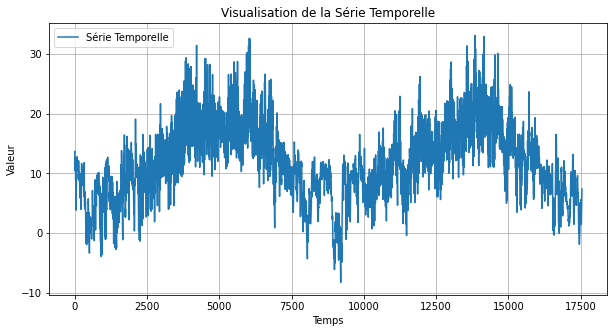

📊 Test de KPSS :
Statistique KPSS : 1.3673159631831147
P-value : 0.01
Seuils critiques : {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
❌ La série n'est PAS stationnaire (on rejette H0)


<ipython-input-29-6945bbf925c9>:23: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is smaller than the p-value returned.

  kpss_stat, p_value, lags, critical_values = kpss(series, regression='c', nlags="auto")


In [ ]:
# On prend le dernier exemple, celui de l'Ile de France pour analyser la stationnarité, la corrélation entre les données, leurs dérivées d'ordre 1 et 2
# Test de stationnarité 
from statsmodels.tsa.stattools import adfuller, kpss  


liste_columns = df_T.columns
# Sélectionner la colonne de la série temporelle
series = df_T[liste_columns[3]]



#  Visualisation de la série temporelle
plt.figure(figsize=(10, 5))
plt.plot(series, label="Série Temporelle")
plt.xlabel("Temps")
plt.ylabel("Valeur")
plt.title("Visualisation de la Série Temporelle")
plt.legend()
plt.grid()
plt.show()

# Test de KPSS
kpss_stat, p_value, lags, critical_values = kpss(series, regression='c', nlags="auto")

# Afficher les résultats
print("📊 Test de KPSS :")
print(f"Statistique KPSS : {kpss_stat}")
print(f"P-value : {p_value}")
print(f"Seuils critiques : {critical_values}")

# Interprétation
if p_value < 0.05:
    print("❌ La série n'est PAS stationnaire (on rejette H0)")
else:
    print("✅ La série est stationnaire (on ne rejette pas H0)")

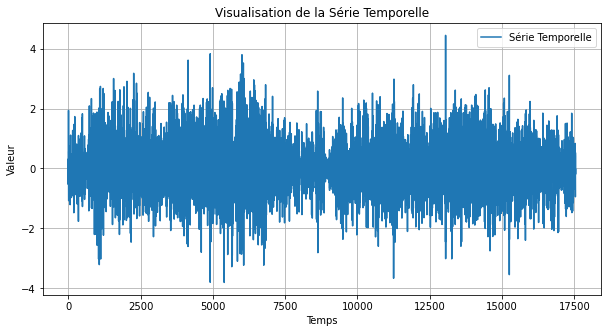

📊 Test de KPSS :
Statistique KPSS : 0.003090064213992669
P-value : 0.1
Seuils critiques : {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
✅ La série est stationnaire (on ne rejette pas H0)


<ipython-input-45-281e49d966fc>:23: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  kpss_stat, p_value, lags, critical_values = kpss(series, regression='c', nlags="auto")


In [45]:
# On prend le dernier exemple, celui de l'Ile de France pour analyser la stationnarité, la corrélation entre les données, leurs dérivées d'ordre 1 et 2
# Test de stationnarité 
from statsmodels.tsa.stattools import adfuller, kpss  


liste_columns = df_T.columns
# Sélectionner la colonne de la série temporelle
 

series = df_diff[liste_columns[3]]
series = series.diff().dropna()
# Visualisation de la série temporelle
plt.figure(figsize=(10, 5))
plt.plot(series, label="Série Temporelle")
plt.xlabel("Temps")
plt.ylabel("Valeur")
plt.title("Visualisation de la Série Temporelle")
plt.legend()
plt.grid()
plt.show()

# Test de KPSS
kpss_stat, p_value, lags, critical_values = kpss(series, regression='c', nlags="auto")

# Afficher les résultats
print("📊 Test de KPSS :")
print(f"Statistique KPSS : {kpss_stat}")
print(f"P-value : {p_value}")
print(f"Seuils critiques : {critical_values}")

# Interprétation
if p_value < 0.05:
    print("❌ La série n'est PAS stationnaire (on rejette H0)")
else:
    print("✅ La série est stationnaire (on ne rejette pas H0)")

Text(0.5, 1.0, 'Île-de-France pair plot')

<Figure size 432x288 with 0 Axes>

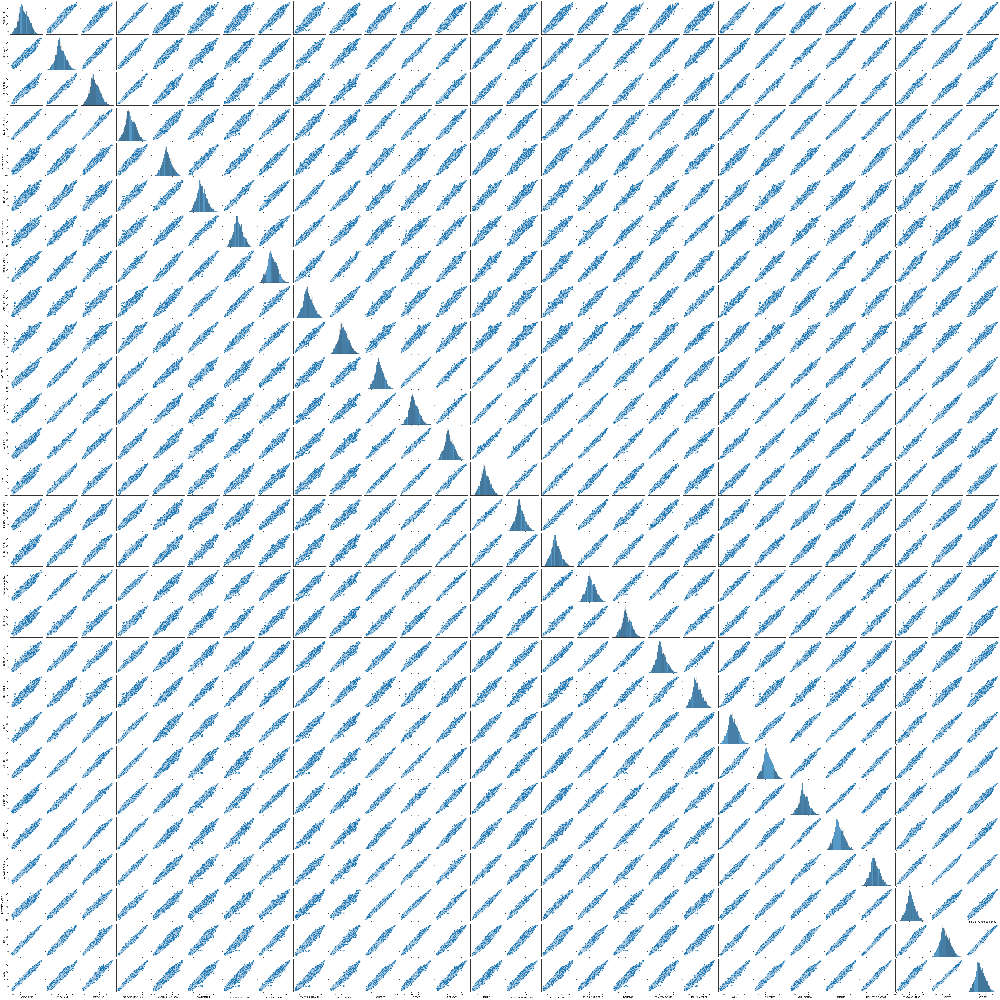

In [8]:
if len(L) > 21 :
    pas = int(len(L)/18)
    L = L[0::pas]
plt.figure()
sns.pairplot(df_T[L])
plt.title(reg +' pair plot')

Text(0.5, 1.0, 'Île-de-France pair plot')

<Figure size 432x288 with 0 Axes>

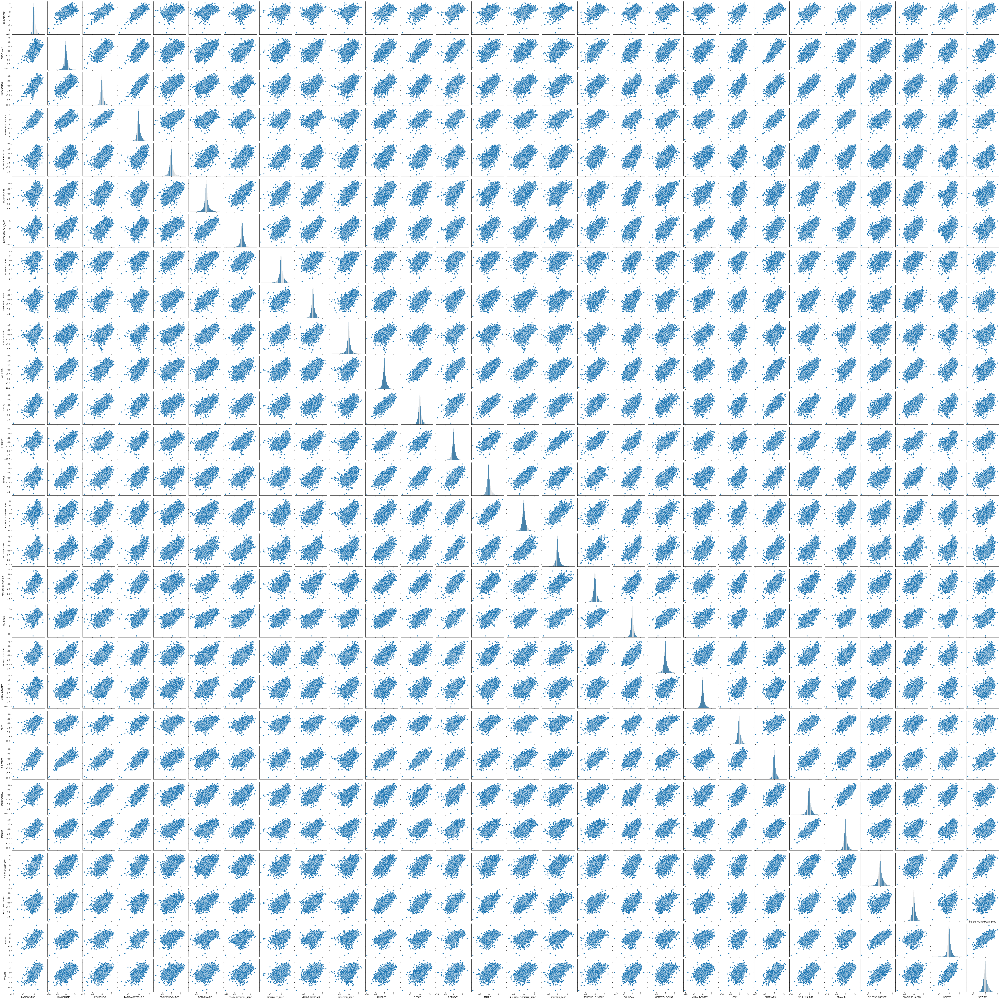

In [9]:
if len(L) > 21 :
    pas = int(len(L)/18)
    L = L[0::pas]
plt.figure()
sns.pairplot(df_diff_1[L])
plt.title(reg +' pair plot')

Text(0.5, 1.0, 'Île-de-France pair plot')

<Figure size 432x288 with 0 Axes>

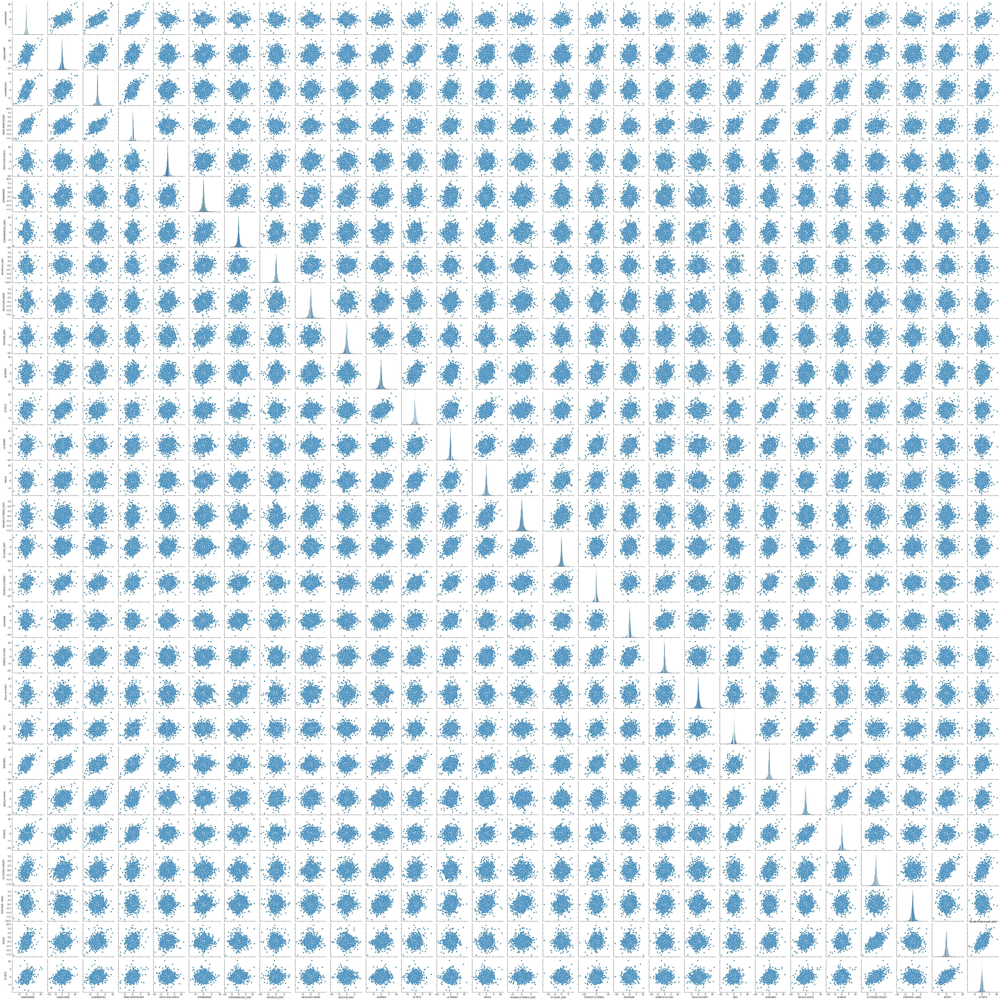

In [11]:
if len(L) > 21 :
    pas = int(len(L)/18)
    L = L[0::pas]
plt.figure()
sns.pairplot(df_diff_2[L])
plt.title(reg +' pair plot')

 Dans ce qui suit nous analysons la distribution du processus moyenne du déparetement centre  géographique de chaque région  :
 - $T_{C_i}(t)) = \frac{1}{N_{C_i}}\sum_{i=1}^{N_{C_i}}T_{ij}(t) $, où  $N_{C_i}$ est le nombre de postes du département centre de la région $i$

In [ ]:
# Comparaison des données météo  des centres géographiques des régions avec des test de similarité de distribution
# pour chaque région on calcule les données météo, moyennées sur les stations du département centre entre 2023 et 2024. Toutes ces données sont regroupées dans un df et regsistrées sous
# T_centre_reg_2023_2024.csv   
# Analyse des distributions (Kolmogorov-Smirnov, KS-test) 

dict_reg_centre = { 'Auvergne-Rhône-Alpes' : 42,
                   'Hauts-de-France' : 80,
                   "Provence-Alpes-Côte-d'Azur" : '01',
                   'Grand-Est' : 55,
                   'Occitanie' : 81,
                   'Normandie' : 14,
                   'Nouvelle-Aquitaine' : 24,
                   'Centre-Val-de-Loire' : 41,
                   'Bourgogne-Franche-Comté' : 21,
                   'Bretagne' : 22,
                   'Pays-de-la-Loire' : 49,
                   'Île-de-France' : 91}


# Un fichir csv par région pour 2020-2023 --> cela nous permet de récupérer 2023
template_start= 'H_' # début du nom du fichier
template_end_2020='_previous-' + str(2020) + '-' + str(2023) + '.csv'


# Un fichir csv par région pour 2024-2025 --> cela nous permet de récupérer 2023
template_end_2024='_latest-' + str(2024) + '-' + str(2025) + '.csv'


# Fichier de sortie
template_start_reg= 'T_' # début du nom du fichier
template_end_reg='-' + str(2023) + '-' + str(2024) + '.csv'

first = True
for reg, dep in dict_reg_centre.items():
    print("... Nous traitons la région", reg)

    # #Lecture de la dataframe avec des données 2020-2023
    filename  = f"{template_start}{dep}{template_end_2020}" 
    file = os.path.join(folder_BD_meteo, filename)
    # Chargement de la base de données 2020-2023
    df_2023_dep =  pd.read_csv(file, sep=';')
    # On ne garde que les lignes de 2023
    df_2023_dep = df_2023_dep.loc[df_2023_dep['AAAAMMJJHH']>=2023010100]
    
    # Lecture des fichiers 2024-2025
    filename  = f"{template_start}{dep}{template_end_2024}" 
    file = os.path.join(folder_BD_meteo, filename)
    # Chargement de la base de données 2024-2025
    df_2024_dep =  pd.read_csv(file, sep=';')
    # On ne garde que les lignes de 2024
    df_2024_dep = df_2024_dep.loc[df_2024_dep['AAAAMMJJHH']<2025010100]


    # Union des deux df 2023 et 2024  
    df_2023_2024 = pd.concat([df_2023_dep, df_2024_dep], ignore_index=True)

    # On transpose les données de chaque poste en une colonne nomme NOM_USUEL_T
    df_2023_2024_pivot = df_2023_2024.pivot(index="AAAAMMJJHH", columns="NOM_USUEL", values="T")

    #aggregation = {"T":[("moyenne_" + reg,'mean'), ('STD_'+ reg, 'std'), ('q25_'+ reg, lambda x : q25(x)),('q50_'+ reg, lambda x : q50(x)), ('q75_'+ reg, lambda x : q75(x)) ]}
    # On calcule la moyenne de tous les postes du département centre à chaque heure
    df_pivot = pd.DataFrame(df_2023_2024_pivot.mean(axis=1), index = df_2023_2024_pivot.index, columns = [reg +'_mean_T'])
    if first == True: # Création d'un nouveau dataframe 
        df_T = df_pivot
        first = False 
    else : 
        df_T = pd.concat([df_T,df_pivot], axis = 1)
    # Extraction et ajout des champs année, mois, jours, heure
    # Maintenant on a un df de la région avec les champs souhaités
    dic = {}
    for col in df_pivot.columns:
        dic[col] = reg +'_' + col
    df_pivot = df_pivot.rename(columns = dic)    
    
df_T = df_T.reset_index()
df_info = pd.to_datetime(df_T['AAAAMMJJHH'].astype(str), format ="%Y%m%d%H").apply(lambda t: pd.Series({'date': t.date(),
                                                                                                        'year': t.year,
                                                                                                        'month': t.month,
                                                                                                        'month_n': t.strftime("%B"),
                                                                                                        'day': t.day,
                                                                                                        'day_n': t.strftime("%A"),
                                                                                                        'h': t.hour + 1,
                                                                                                        'mn': t.minute}))
df_T[df_info.columns] = df_info
filename = f"{template_start_reg}{'centre_reg'}{template_end_reg}" 
file = os.path.join(folder_BD_meteo_region_centre, filename)
df_T.reset_index()
df_T.to_csv(file, index=False)

In [ ]:
# Comparaison des données météo  des centres géographiques des régions avec des test de similarité de distribution
# Analyse des distributions (Kolmogorov-Smirnov, KS-test) 
# 
dict_reg_centre = { 'Auvergne-Rhône-Alpes' : 42,
                   'Hauts-de-France' : 80,
                   "Provence-Alpes-Côte-d'Azur" : '01',
                   'Grand-Est' : 55,
                   'Occitanie' : 81,
                   'Normandie' : 14,
                   'Nouvelle-Aquitaine' : 24,
                   'Centre-Val-de-Loire' : 41,
                   'Bourgogne-Franche-Comté' : 21,
                   'Bretagne' : 22,
                   'Pays-de-la-Loire' : 49,
                   'Île-de-France' : 91}




template_start_reg= 'T_Centre_Region_' # début du nom du fichier
template_end_reg='-' + str(2020) + '-' + str(2023) + '.csv'


filename = f"{template_start_reg}{'centre_reg'}{template_end_reg}" 
file = os.path.join(folder_BD_meteo_region_centre, filename)
df_T = pd.read_csv(file)

In [20]:

df_T.head()

,AAAAMMJJHH,Auvergne-Rhône-Alpes_mean_T,Hauts-de-France_mean_T,Provence-Alpes-Côte-d'Azur_mean_T,Grand-Est_mean_T,Occitanie_mean_T,Normandie_mean_T,Nouvelle-Aquitaine_mean_T,Centre-Val-de-Loire_mean_T,Bourgogne-Franche-Comté_mean_T,...,Pays-de-la-Loire_mean_T,Île-de-France_mean_T,date,year,month,month_n,day,day_n,h,mn
0,2023010100,11.255556,13.60625,10.78750,12.835294,9.17,13.900000,11.821429,13.883333,10.840,...,13.921053,13.250000,2023-01-01,2023,1,January,1,Sunday,1,0
1,2023010101,11.259259,13.56250,11.07500,13.023529,8.81,13.623529,11.550000,13.925000,10.500,...,13.478947,13.150000,2023-01-01,2023,1,January,1,Sunday,2,0
2,2023010102,11.025926,13.68750,10.83750,12.994118,9.02,13.294118,10.907143,13.725000,10.720,...,13.105263,12.883333,2023-01-01,2023,1,January,1,Sunday,3,0
3,2023010103,10.788889,13.35000,10.91875,13.011765,8.92,12.770588,10.550000,13.283333,10.724,...,12.894737,12.850000,2023-01-01,2023,1,January,1,Sunday,4,0
4,2023010104,10.725926,12.85625,10.95625,12.788235,8.50,12.188235,10.721429,12.858333,10.708,...,12.763158,12.916667,2023-01-01,2023,1,January,1,Sunday,5,0


In [21]:
print(df_T.columns)

Index(['AAAAMMJJHH', 'Auvergne-Rhône-Alpes_mean_T', 'Hauts-de-France_mean_T',
       'Provence-Alpes-Côte-d'Azur_mean_T', 'Grand-Est_mean_T',
       'Occitanie_mean_T', 'Normandie_mean_T', 'Nouvelle-Aquitaine_mean_T',
       'Centre-Val-de-Loire_mean_T', 'Bourgogne-Franche-Comté_mean_T',
       'Bretagne_mean_T', 'Pays-de-la-Loire_mean_T', 'Île-de-France_mean_T',
       'date', 'year', 'month', 'month_n', 'day', 'day_n', 'h', 'mn'],
      dtype='object')


In [47]:
# Test  de Kolmogorov-Smirnov (KS) pour voir si les distributions sont similaires 

columns_a_garder = ["Auvergne-Rhône-Alpes_mean_T", "Hauts-de-France_mean_T", "Provence-Alpes-Côte-d'Azur_mean_T", 'Grand-Est_mean_T', 'Occitanie_mean_T', 'Normandie_mean_T', 'Nouvelle-Aquitaine_mean_T', 'Centre-Val-de-Loire_mean_T', 'Bourgogne-Franche-Comté_mean_T','Bretagne_mean_T', 'Pays-de-la-Loire_mean_T', 'Île-de-France_mean_T']

df_for_stat = df_T[columns_a_garder]

for col1 in columns_a_garder :
    for col2 in columns_a_garder:
        if col1 != col2:
            ks_stat, p_value = ks_2samp(df_for_stat[col1], df_for_stat[col2])
            if (p_value > 0.01):
                print(f"KS Test Statistique entre {col1} et {col2} : {ks_stat}, P-value : {p_value}")

KS Test Statistique entre Centre-Val-de-Loire_mean_T et Île-de-France_mean_T : 0.013622891016871863, P-value : 0.0763892304630106
KS Test Statistique entre Île-de-France_mean_T et Centre-Val-de-Loire_mean_T : 0.013622891016871863, P-value : 0.0763892304630106


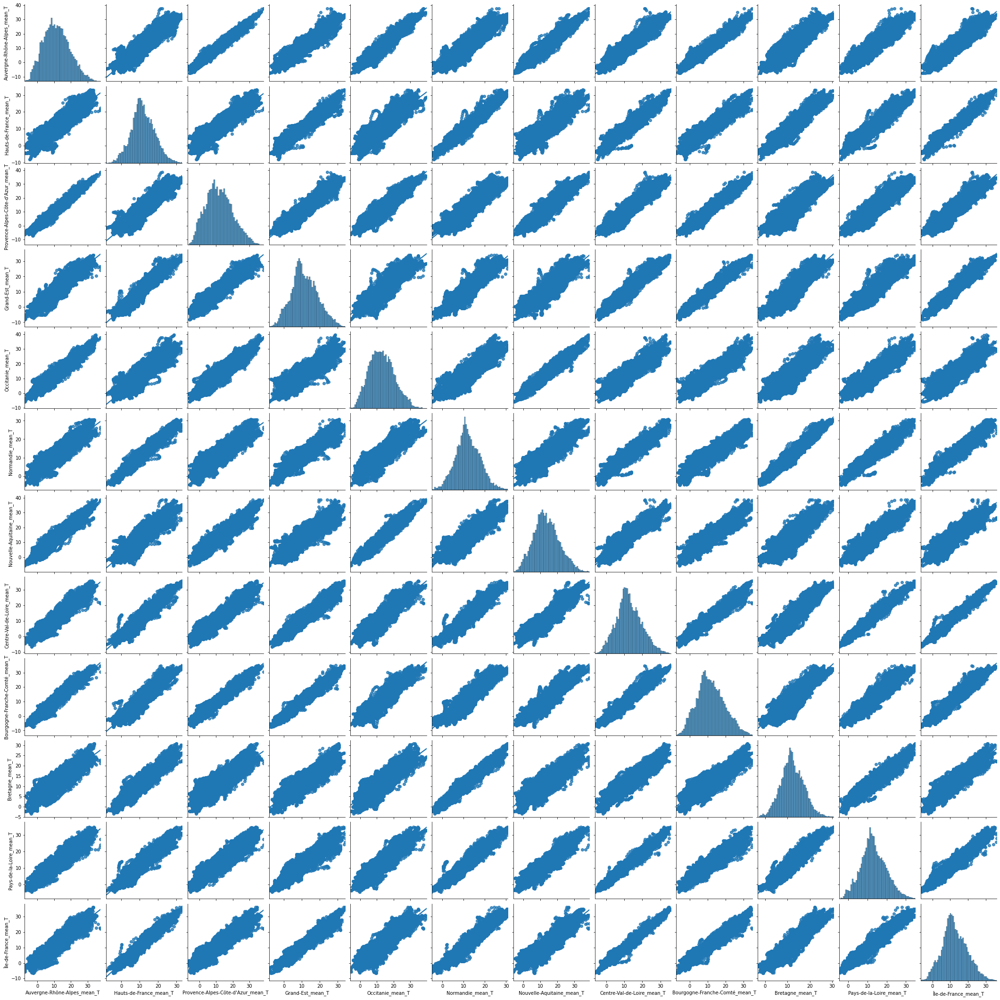

In [23]:
sns.pairplot(df_for_stat,kind= 'reg', diag_kind = 'hist' ) 

In [ ]:


corr_pearson = df_for_stat.corr(method='pearson')  # Corrélation linéaire
    #corr_spearman = df_T[L].corr(method='spearman')  # Corrélation monotone
    
print("Corrélation Pearson")
display(corr_pearson)



Corrélation Pearson


,Auvergne-Rhône-Alpes_mean_T,Hauts-de-France_mean_T,Provence-Alpes-Côte-d'Azur_mean_T,Grand-Est_mean_T,Occitanie_mean_T,Normandie_mean_T,Nouvelle-Aquitaine_mean_T,Centre-Val-de-Loire_mean_T,Bourgogne-Franche-Comté_mean_T,Bretagne_mean_T,Pays-de-la-Loire_mean_T,Île-de-France_mean_T
Auvergne-Rhône-Alpes_mean_T,1.000000,0.903650,0.978929,0.937065,0.962050,0.899581,0.955308,0.937453,0.970358,0.879222,0.920036,0.928650
Hauts-de-France_mean_T,0.903650,1.000000,0.904525,0.955178,0.876685,0.967068,0.891513,0.952922,0.937386,0.932741,0.942468,0.969658
Provence-Alpes-Côte-d'Azur_mean_T,0.978929,0.904525,1.000000,0.945614,0.947464,0.889457,0.946562,0.934094,0.973310,0.868847,0.912829,0.929947
Grand-Est_mean_T,0.937065,0.955178,0.945614,1.000000,0.899195,0.924973,0.913756,0.958922,0.977750,0.893575,0.933587,0.968824
Occitanie_mean_T,0.962050,0.876685,0.947464,0.899195,1.000000,0.882739,0.970040,0.915045,0.933589,0.871567,0.908866,0.902732
Normandie_mean_T,0.899581,0.967068,0.889457,0.924973,0.882739,1.000000,0.898327,0.951005,0.921346,0.971120,0.960398,0.954547
Nouvelle-Aquitaine_mean_T,0.955308,0.891513,0.946562,0.913756,0.970040,0.898327,1.000000,0.942587,0.944803,0.886390,0.937733,0.923967
Centre-Val-de-Loire_mean_T,0.937453,0.952922,0.934094,0.958922,0.915045,0.951005,0.942587,1.000000,0.964689,0.926329,0.978592,0.984789
Bourgogne-Franche-Comté_mean_T,0.970358,0.937386,0.973310,0.977750,0.933589,0.921346,0.944803,0.964689,1.000000,0.895715,0.940029,0.963384
Bretagne_mean_T,0.879222,0.932741,0.868847,0.893575,0.871567,0.971120,0.886390,0.926329,0.895715,1.000000,0.949960,0.923297


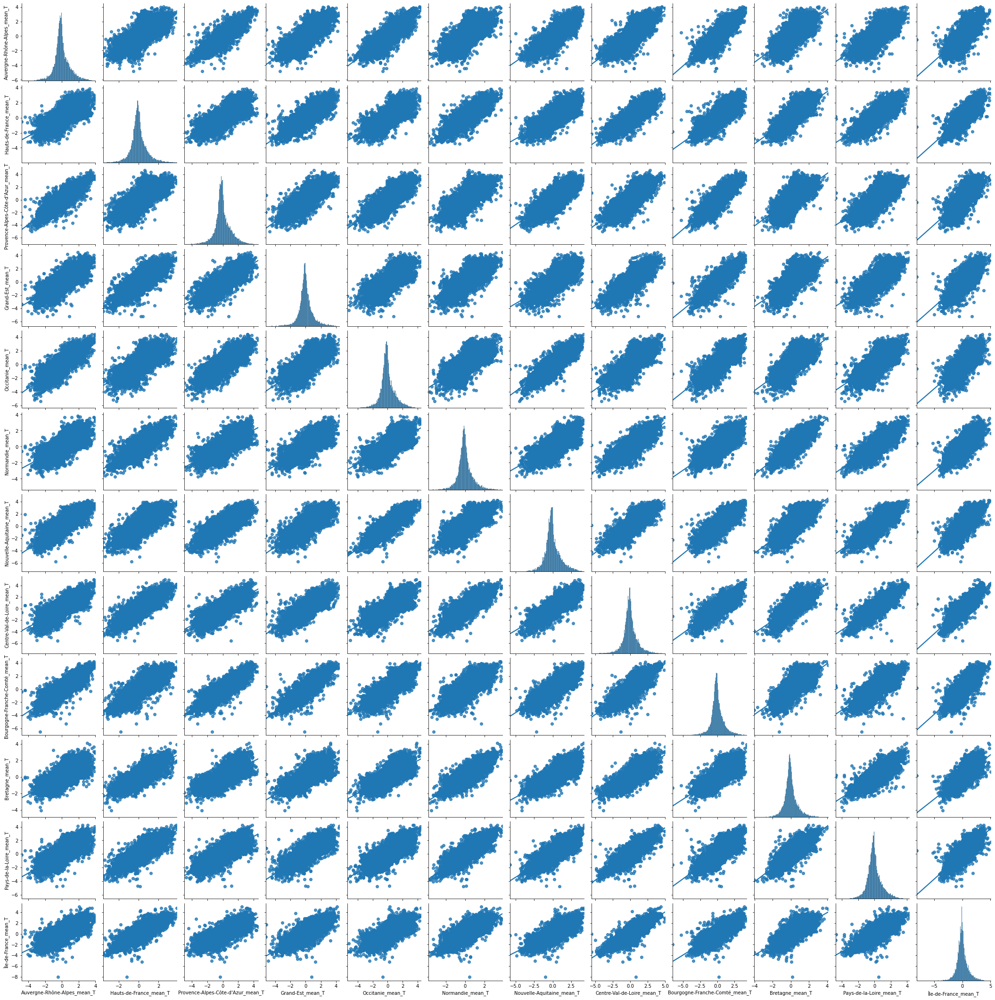

In [25]:
count = 0
df_diff = df_for_stat.diff().dropna()

sns.pairplot(df_diff,kind= 'reg', diag_kind = 'hist' ) 

In [50]:
df_diff_1 = df_for_stat.diff().dropna()
for col1 in df_diff_1.columns :
    for col2 in df_diff_1.columns:
        if col1 != col2:
            ks_stat, p_value = ks_2samp(df_diff_1[col1], df_diff_1[col2])
            if (p_value > 0.01):
                print(f"KS Test Statistique entre {col1} et {col2} : {ks_stat}, P-value : {p_value}")
            #print(f"KS Test Statistique entre {col1} et {col2} : {ks_stat}, P-value : {p_value}")

KS Test Statistique entre Auvergne-Rhône-Alpes_mean_T et Pays-de-la-Loire_mean_T : 0.015276748560679398, P-value : 0.03298992602531303
KS Test Statistique entre Hauts-de-France_mean_T et Normandie_mean_T : 0.012939634042068077, P-value : 0.10507050037890864
KS Test Statistique entre Provence-Alpes-Côte-d'Azur_mean_T et Occitanie_mean_T : 0.01425069828421588, P-value : 0.05617271844324623
KS Test Statistique entre Occitanie_mean_T et Provence-Alpes-Côte-d'Azur_mean_T : 0.01425069828421588, P-value : 0.05617271844324623
KS Test Statistique entre Normandie_mean_T et Hauts-de-France_mean_T : 0.012939634042068077, P-value : 0.10507050037890864
KS Test Statistique entre Normandie_mean_T et Bretagne_mean_T : 0.015162742974405674, P-value : 0.03506363463719531
KS Test Statistique entre Centre-Val-de-Loire_mean_T et Île-de-France_mean_T : 0.010089494385224856, P-value : 0.3314951963570797
KS Test Statistique entre Bretagne_mean_T et Normandie_mean_T : 0.015162742974405674, P-value : 0.035063634

In [26]:
df_diff_2 = df_for_stat.diff().diff().dropna()
corr_pearson = df_diff_2.corr(method='pearson')  # Corrélation linéaire
    #corr_spearman = df_T[L].corr(method='spearman')  # Corrélation monotone
    
print("Corrélation Pearson")
display(corr_pearson)

Corrélation Pearson


,Auvergne-Rhône-Alpes_mean_T,Hauts-de-France_mean_T,Provence-Alpes-Côte-d'Azur_mean_T,Grand-Est_mean_T,Occitanie_mean_T,Normandie_mean_T,Nouvelle-Aquitaine_mean_T,Centre-Val-de-Loire_mean_T,Bourgogne-Franche-Comté_mean_T,Bretagne_mean_T,Pays-de-la-Loire_mean_T,Île-de-France_mean_T
Auvergne-Rhône-Alpes_mean_T,1.000000,0.384135,0.535406,0.442247,0.494366,0.359229,0.471543,0.430276,0.530247,0.335037,0.385626,0.330954
Hauts-de-France_mean_T,0.384135,1.000000,0.403872,0.452653,0.379766,0.456401,0.444483,0.483313,0.450462,0.416850,0.452593,0.401511
Provence-Alpes-Côte-d'Azur_mean_T,0.535406,0.403872,1.000000,0.448841,0.482226,0.368650,0.485014,0.428413,0.541066,0.342548,0.396319,0.359400
Grand-Est_mean_T,0.442247,0.452653,0.448841,1.000000,0.403180,0.374277,0.426923,0.454013,0.537923,0.327822,0.394247,0.366631
Occitanie_mean_T,0.494366,0.379766,0.482226,0.403180,1.000000,0.363907,0.539731,0.422950,0.472010,0.341887,0.402362,0.322205
Normandie_mean_T,0.359229,0.456401,0.368650,0.374277,0.363907,1.000000,0.422905,0.452746,0.400057,0.447713,0.475234,0.351087
Nouvelle-Aquitaine_mean_T,0.471543,0.444483,0.485014,0.426923,0.539731,0.422905,1.000000,0.496218,0.497459,0.415637,0.499219,0.368237
Centre-Val-de-Loire_mean_T,0.430276,0.483313,0.428413,0.454013,0.422950,0.452746,0.496218,1.000000,0.493557,0.412084,0.494996,0.431238
Bourgogne-Franche-Comté_mean_T,0.530247,0.450462,0.541066,0.537923,0.472010,0.400057,0.497459,0.493557,1.000000,0.375613,0.436577,0.397495
Bretagne_mean_T,0.335037,0.416850,0.342548,0.327822,0.341887,0.447713,0.415637,0.412084,0.375613,1.000000,0.454031,0.328165


In [48]:

for col1 in df_diff_2.columns :
    for col2 in df_diff_2.columns:
        if col1 != col2:
            ks_stat, p_value = ks_2samp(df_diff_2[col1], df_diff_2[col2])
            if (p_value > 0.01):
                print(f"KS Test Statistique entre {col1} et {col2} : {ks_stat}, P-value : {p_value}")
            #print(f"KS Test Statistique entre {col1} et {col2} : {ks_stat}, P-value : {p_value}")

KS Test Statistique entre Auvergne-Rhône-Alpes_mean_T et Centre-Val-de-Loire_mean_T : 0.012883365636757516, P-value : 0.10782206950445528
KS Test Statistique entre Hauts-de-France_mean_T et Normandie_mean_T : 0.00912096682248309, P-value : 0.45627193590029047
KS Test Statistique entre Grand-Est_mean_T et Bourgogne-Franche-Comté_mean_T : 0.01681678257895336, P-value : 0.013853715178499154
KS Test Statistique entre Occitanie_mean_T et Centre-Val-de-Loire_mean_T : 0.017044806749515473, P-value : 0.012096802955506237
KS Test Statistique entre Normandie_mean_T et Hauts-de-France_mean_T : 0.00912096682248309, P-value : 0.45627193590029047
KS Test Statistique entre Centre-Val-de-Loire_mean_T et Auvergne-Rhône-Alpes_mean_T : 0.012883365636757516, P-value : 0.10782206950445528
KS Test Statistique entre Centre-Val-de-Loire_mean_T et Occitanie_mean_T : 0.017044806749515473, P-value : 0.012096802955506237
KS Test Statistique entre Bourgogne-Franche-Comté_mean_T et Grand-Est_mean_T : 0.016816782578

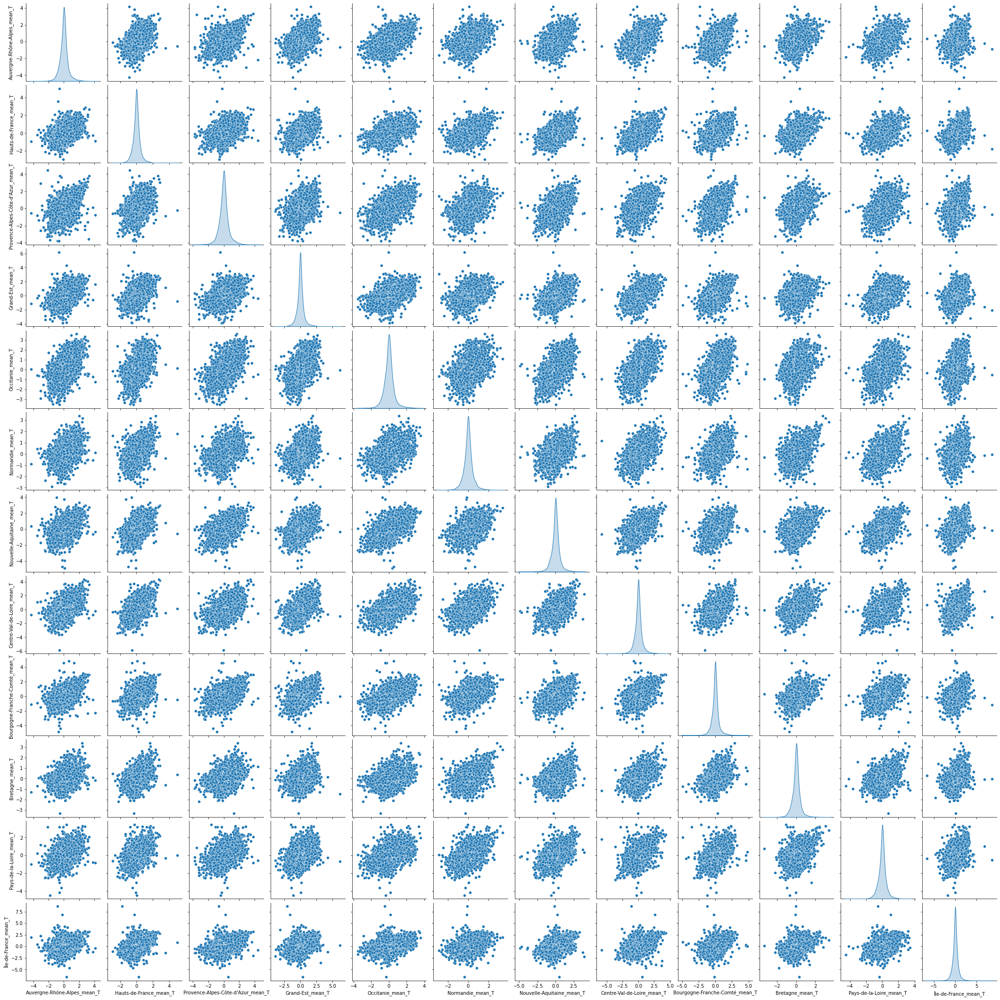

In [28]:
sns.pairplot(df_diff_2, diag_kind = 'kde') 

In [ ]:



fig = plt.figure(figsize=(20,10))

plt.subplot(131)
stats.probplot(df_for_stat['Auvergne-Rhône-Alpes_mean_T'], dist="norm", plot=pylab)

plt.xlabel('Quantiles théoriques')
plt.ylabel('Quantiles observés')
plt.title('qq-plot - Droite de Henry')
plt.grid(True, linestyle = '--')


fig = plt.subplot(132)
stats.probplot(df_for_stat['Normandie_mean_T'], dist="norm", plot=pylab)

plt.xlabel('Quantiles théoriques')
plt.ylabel('Quantiles observés')
plt.title('qq-plot - Droite de Henry')
plt.grid(True, linestyle = '--')

fig = plt.subplot(133)
stats.probplot(df_for_stat['Bretagne_mean_T'], dist="norm", plot=pylab)

plt.xlabel('Quantiles théoriques')
plt.ylabel('Quantiles observés')
plt.title('qq-plot - Droite de Henry')
plt.grid(True, linestyle = '--')


In [ ]:


# Chargement des données (exemple)

# Visualisation de la série temporelle
plt.figure(figsize=(10, 5))
plt.plot(df_T[['Auvergne-Rhône-Alpes_mean_T']], label="Série Temporelle")
plt.xlabel("Temps")
plt.ylabel("Valeur")
plt.legend()
plt.show()




In [ ]:
# Appliquer la décomposition (modèle additif ou multiplicatif)
decomposed = seasonal_decompose(df_T[['Auvergne-Rhône-Alpes_mean_T']], model="additive", period=365)

# Tracer les composantes
plt.figure(figsize=(12, 8))

plt.subplot(411)
plt.plot(decomposed.observed, label="Original")
plt.legend()

plt.subplot(412)
plt.plot(decomposed.trend, label="Tendance", color="orange")
plt.legend()

plt.subplot(413)
plt.plot(decomposed.seasonal, label="Saisonnalité", color="green")
plt.legend()

plt.subplot(414)
plt.plot(decomposed.resid, label="Résidu", color="red")
plt.legend()

plt.show()

In [ ]:
plt.figure(figsize=(20, 8))
plt.subplot(141)
stats.probplot(decomposed.observed, dist="norm", plot=pylab)

plt.xlabel('Quantiles théoriques')
plt.ylabel('Quantiles observés')
plt.title('qq-plot - Droite de Henry')
plt.grid(True, linestyle = '--')


plt.subplot(142)
stats.probplot(decomposed.seasonal, dist="norm", plot=pylab)

plt.xlabel('Quantiles théoriques')
plt.ylabel('Quantiles observés')
plt.title('qq-plot - Droite de Henry')
plt.grid(True, linestyle = '--')

plt.subplot(143)
stats.probplot(decomposed.trend, dist="norm", plot=pylab)

plt.xlabel('Quantiles théoriques')
plt.ylabel('Quantiles observés')
plt.title('qq-plot - Droite de Henry')
plt.grid(True, linestyle = '--')

plt.subplot(144)
stats.probplot(decomposed.resid, dist="norm", plot=pylab)

plt.xlabel('Quantiles théoriques')
plt.ylabel('Quantiles observés')
plt.title('qq-plot - Droite de Henry')
plt.grid(True, linestyle = '--')

plt.show()


In [ ]:






folder = r"D:\MesDocuments\Formation\DataScientist_PSL\Projet\BD\Meteo\region"
# Fichier de sortie
template_start_reg= 'H_' # début du nom du fichier
template_end_reg='-' + str(2023) + '-' + str(2024) + '.csv'
first = True
for reg in Liste_region:
    print("... Nous traitons la région", reg)
    
    # #Lecture de la dataframe avec des données 2020-2023
    filename  = f"{template_start_reg}{reg}{template_end_reg}" 
    file = os.path.join(folder, filename)
    print(file)
    # Chargement de la base de données 2020-2023
    df_reg =  pd.read_csv(file)
    # on concaténe aeavec la df de la région
    if first == True: # Création d'un nouveau dataframe
        df_T_moyenne = df_reg[['AAAAMMJJHH', 'T_moyenne']]
        first = False 
    else : 
        df_T_moyenne = pd.concat([df_T_moyenne,df_reg[['T_moyenne']]], axis = 1)
     


... Nous traitons la région Auvergne-Rhône-Alpes
D:\MesDocuments\Formation\DataScientist_PSL\Projet\BD\Meteo\region\H_Auvergne-Rhône-Alpes-2023-2024.csv
... Nous traitons la région Hauts-de-France
D:\MesDocuments\Formation\DataScientist_PSL\Projet\BD\Meteo\region\H_Hauts-de-France-2023-2024.csv
... Nous traitons la région Provence-Alpes-Côte-d'Azur
D:\MesDocuments\Formation\DataScientist_PSL\Projet\BD\Meteo\region\H_Provence-Alpes-Côte-d'Azur-2023-2024.csv
... Nous traitons la région Grand-Est
D:\MesDocuments\Formation\DataScientist_PSL\Projet\BD\Meteo\region\H_Grand-Est-2023-2024.csv
... Nous traitons la région Occitanie
D:\MesDocuments\Formation\DataScientist_PSL\Projet\BD\Meteo\region\H_Occitanie-2023-2024.csv
... Nous traitons la région Normandie
D:\MesDocuments\Formation\DataScientist_PSL\Projet\BD\Meteo\region\H_Normandie-2023-2024.csv
... Nous traitons la région Nouvelle-Aquitaine
D:\MesDocuments\Formation\DataScientist_PSL\Projet\BD\Meteo\region\H_Nouvelle-Aquitaine-2023-2024.c

In [87]:
df_T_moyenne.head()

,Auvergne-Rhône-Alpes,Hauts-de-France,Provence-Alpes-Côte-d'Azur,Grand-Est,Occitanie,Normandie,Nouvelle-Aquitaine,Centre-Val-de-Loire,Bourgogne-Franche-Comté,Bretagne,Pays-de-la-Loire,Île-de-France
AAAAMMJJHH,,,,,,,,,,,,
2023010100,9.610677,13.573134,9.106897,12.718644,10.253112,13.74250,12.178302,13.320408,12.545588,12.355263,13.717073,14.008333
2023010101,9.486198,13.632836,8.953793,12.565537,10.164730,13.51500,12.144811,13.213265,12.472794,12.159211,13.331707,13.943750
2023010102,9.332812,13.549254,8.935172,12.475706,10.128216,13.16750,12.025000,12.879592,12.416912,11.915789,12.973171,13.722917
2023010103,9.146354,12.988060,8.808966,12.392655,10.017012,12.75500,11.671698,12.462245,12.361765,11.686842,12.746341,13.429167
2023010104,8.933333,12.700000,8.757931,12.198870,9.940664,12.30625,11.385377,12.040816,12.269118,11.642105,12.523171,13.195833


In [86]:
#df_T_moyenne.set_index('AAAAMMJJHH', inplace=True)
df_T_moyenne.set_axis(Liste_region, axis='columns', inplace=True)

In [88]:

df_T_moyenne.info()




<class 'pandas.core.frame.DataFrame'>
Int64Index: 17544 entries, 2023010100 to 2024123123
Data columns (total 12 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Auvergne-Rhône-Alpes        17544 non-null  float64
 1   Hauts-de-France             17544 non-null  float64
 2   Provence-Alpes-Côte-d'Azur  17544 non-null  float64
 3   Grand-Est                   17544 non-null  float64
 4   Occitanie                   17544 non-null  float64
 5   Normandie                   17544 non-null  float64
 6   Nouvelle-Aquitaine          17544 non-null  float64
 7   Centre-Val-de-Loire         17544 non-null  float64
 8   Bourgogne-Franche-Comté     17544 non-null  float64
 9   Bretagne                    17544 non-null  float64
 10  Pays-de-la-Loire            17544 non-null  float64
 11  Île-de-France               17544 non-null  float64
dtypes: float64(12)
memory usage: 1.7 MB


In [101]:
df_T_moyenne_diff = df_T_moyenne #.diff()
for col1 in df_T_moyenne_diff.columns :
    for col2 in df_T_moyenne_diff.columns:
        if col1 != col2:
            ks_stat, p_value = ks_2samp(df_T_moyenne_diff[col1], df_T_moyenne_diff[col2])
            if p_value > 0.05 :
                print(f"KS Test Statistique entre {col1} et {col2} : {ks_stat}, P-value : {p_value}")


KS Test Statistique entre Grand-Est et Bourgogne-Franche-Comté : 0.011570907432740557, P-value : 0.1893190405844435
KS Test Statistique entre Centre-Val-de-Loire et Île-de-France : 0.012881896944824417, P-value : 0.10785795510040619
KS Test Statistique entre Bourgogne-Franche-Comté et Grand-Est : 0.011570907432740557, P-value : 0.1893190405844435
KS Test Statistique entre Île-de-France et Centre-Val-de-Loire : 0.012881896944824417, P-value : 0.10785795510040619


In [84]:
df_T_moyenne_diff.columns

Index(['T_moyenne', 'T_moyenne', 'T_moyenne', 'T_moyenne', 'T_moyenne',
       'T_moyenne', 'T_moyenne', 'T_moyenne', 'T_moyenne', 'T_moyenne',
       'T_moyenne', 'T_moyenne'],
      dtype='object')

In [102]:
corr_pearson = df_T_moyenne_diff.corr(method='pearson')  # Corrélation linéaire
    #corr_spearman = df_T[L].corr(method='spearman')  # Corrélation monotone
    
print("Corrélation Pearson")
display(corr_pearson)

Corrélation Pearson


,Auvergne-Rhône-Alpes,Hauts-de-France,Provence-Alpes-Côte-d'Azur,Grand-Est,Occitanie,Normandie,Nouvelle-Aquitaine,Centre-Val-de-Loire,Bourgogne-Franche-Comté,Bretagne,Pays-de-la-Loire,Île-de-France
Auvergne-Rhône-Alpes,1.000000,0.918893,0.964522,0.955229,0.977814,0.912168,0.962917,0.949585,0.977067,0.891448,0.921823,0.932466
Hauts-de-France,0.918893,1.000000,0.879059,0.963792,0.896079,0.977591,0.913322,0.961673,0.945677,0.936112,0.950881,0.985063
Provence-Alpes-Côte-d'Azur,0.964522,0.879059,1.000000,0.910600,0.965588,0.874766,0.923802,0.904239,0.928204,0.861343,0.883325,0.890059
Grand-Est,0.955229,0.963792,0.910600,1.000000,0.921673,0.939361,0.932794,0.967576,0.987673,0.904652,0.938218,0.971477
Occitanie,0.977814,0.896079,0.965588,0.921673,1.000000,0.900924,0.974459,0.936241,0.946548,0.890974,0.918723,0.912549
Normandie,0.912168,0.977591,0.874766,0.939361,0.900924,1.000000,0.927031,0.965300,0.932370,0.973042,0.975155,0.974020
Nouvelle-Aquitaine,0.962917,0.913322,0.923802,0.932794,0.974459,0.927031,1.000000,0.967611,0.956749,0.920080,0.956337,0.935043
Centre-Val-de-Loire,0.949585,0.961673,0.904239,0.967576,0.936241,0.965300,0.967611,1.000000,0.974302,0.941119,0.979663,0.983092
Bourgogne-Franche-Comté,0.977067,0.945677,0.928204,0.987673,0.946548,0.932370,0.956749,0.974302,1.000000,0.903705,0.941051,0.961911
Bretagne,0.891448,0.936112,0.861343,0.904652,0.890974,0.973042,0.920080,0.941119,0.903705,1.000000,0.973018,0.936745


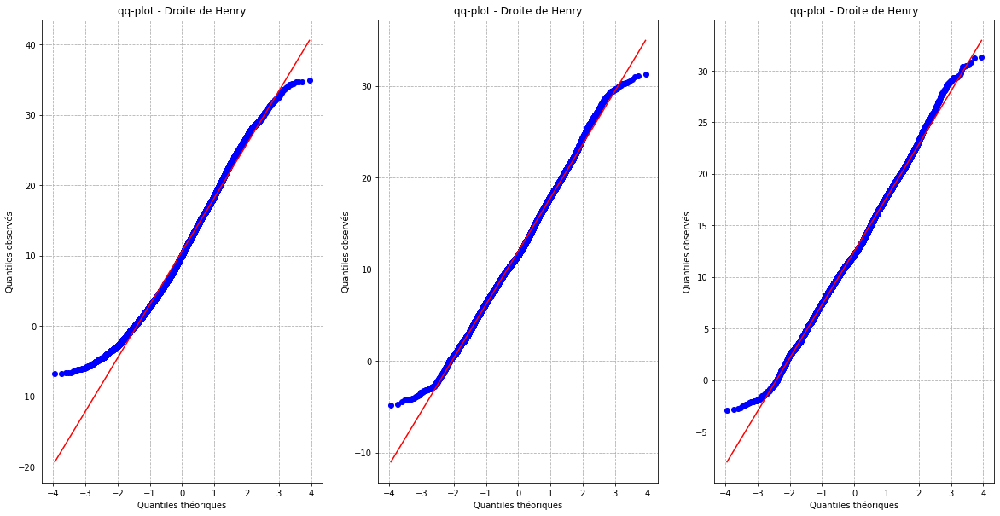

In [103]:
fig = plt.figure(figsize=(20,10))

plt.subplot(131)
stats.probplot(df_T_moyenne_diff['Auvergne-Rhône-Alpes'], dist="norm", plot=pylab)

plt.xlabel('Quantiles théoriques')
plt.ylabel('Quantiles observés')
plt.title('qq-plot - Droite de Henry')
plt.grid(True, linestyle = '--')


fig = plt.subplot(132)
stats.probplot(df_T_moyenne_diff['Normandie'], dist="norm", plot=pylab)

plt.xlabel('Quantiles théoriques')
plt.ylabel('Quantiles observés')
plt.title('qq-plot - Droite de Henry')
plt.grid(True, linestyle = '--')

fig = plt.subplot(133)
stats.probplot(df_T_moyenne_diff['Bretagne'], dist="norm", plot=pylab)

plt.xlabel('Quantiles théoriques')
plt.ylabel('Quantiles observés')
plt.title('qq-plot - Droite de Henry')
plt.grid(True, linestyle = '--')

Statistique de Kolmogorov-Smirnov : 0.9424
p-value : 0.0000


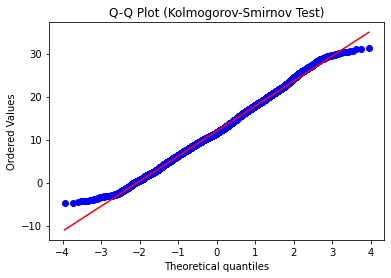

Les données ne suivent pas une distribution normale (p-value < 0.05).


In [107]:
import numpy as np
from scipy import stats
import matplotlib.pyplot as plt



# Test de Kolmogorov-Smirnov
D_statistic, p_value = stats.kstest(df_T_moyenne_diff['Normandie'], 'norm')

# Affichage des résultats
print(f"Statistique de Kolmogorov-Smirnov : {D_statistic:.4f}")
print(f"p-value : {p_value:.4f}")

# Visualisation avec un Q-Q plot pour observer la normalité
plt.figure(figsize=(6, 4))
stats.probplot(df_T_moyenne_diff['Normandie'], dist="norm", plot=plt)
plt.title("Q-Q Plot (Kolmogorov-Smirnov Test)")
plt.show()

# Interprétation
if p_value > 0.05:
    print("Les données suivent une distribution normale (p-value > 0.05).")
else:
    print("Les données ne suivent pas une distribution normale (p-value < 0.05).")